In [24]:
import cv2
import random
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import pytesseract
pytesseract.pytesseract.tesseract_cmd = 'C:\\Program Files\\Tesseract-OCR\\tesseract.exe'

%matplotlib inline

In [25]:
images_dir = "./../data/kaggle"
image_files = os.listdir(images_dir)

In [26]:
df = pd.read_json("C:\\Users\\Keshav Gupta\\Pictures\\Space-app project\\License Plate Recognition\\data\\kaggle\\Indian_Number_plates.json", lines=True)
df.head()

,content,annotation,extras
0,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
1,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
2,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
3,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
4,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN


In [27]:
df.shape

(237, 3)

In [28]:
new_csv=df.to_csv("indian_license_plates.csv", index=False)

In [29]:
new_df=pd.read_csv("C:\\Users\\Keshav Gupta\\Pictures\\Space-app project\\License Plate Recognition\\notebooks\\indian_license_plates.csv")
new_df.head(10)

,content,annotation,extras
0,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
1,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
2,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
3,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
4,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
5,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
6,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
7,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
8,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
9,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN


In [31]:
import urllib3

from PIL import Image
from urllib.request import urlopen

In [32]:

os.mkdir("Indian Number Plates")

In [33]:

dataset = dict()
dataset["image_name"] = list()
dataset["image_width"] = list()
dataset["image_height"] = list()
dataset["top_x"] = list()
dataset["top_y"] = list()
dataset["bottom_x"] = list()
dataset["bottom_y"] = list()

In [34]:
from tqdm import tqdm

In [35]:
counter = 0

for index, row in tqdm(df.iterrows()):
    # Iterate over DataFrame rows as (index, Series) pairs.
    # Here series is a pandas series.
    # print("Trying to fetch image: ",row["content"])
    res = urlopen(row["content"])
    # This line here is trying to access the url being pointed to in each row, where iamge is saved.
    
    img = Image.open(res)
    img = img.convert('RGB')
    # Returns a converted copy of this image.
    
    img.save("Indian Number Plates/licensed_car{}.jpeg".format(counter), "JPEG")
    # Saves the image under the given filename.
    
    # Create a dataset for all the images with properties.
    dataset["image_name"].append("licensed_car{}".format(counter))

    data = row["annotation"]
    
    dataset["image_width"].append(data[0]["imageWidth"])
    dataset["image_height"].append(data[0]["imageHeight"])
    dataset["top_x"].append(data[0]["points"][0]["x"])
    dataset["top_y"].append(data[0]["points"][0]["y"])
    dataset["bottom_x"].append(data[0]["points"][1]["x"])
    dataset["bottom_y"].append(data[0]["points"][1]["y"])
    
    counter += 1
print("Downloaded {} car images.".format(counter))

237it [04:56,  1.25s/it]

Downloaded 237 car images.


In [36]:
df_changed = pd.DataFrame(dataset)

df_changed.to_csv("ConvertedImagesProperties.csv", index=False)

In [37]:
license_plate_df = pd.read_csv("ConvertedImagesProperties.csv")
license_plate_df["image_name"] = license_plate_df["image_name"] + ".jpeg"
license_plate_df.drop(["image_width", "image_height"], axis=1, inplace=True)
license_plate_df.head()

,image_name,top_x,top_y,bottom_x,bottom_y
0,licensed_car0.jpeg,0.722084,0.587983,0.868486,0.688841
1,licensed_car1.jpeg,0.161943,0.850780,0.582996,1.000000
2,licensed_car2.jpeg,0.082000,0.697452,0.230000,0.828025
3,licensed_car3.jpeg,0.434000,0.667377,0.718000,0.765458
4,licensed_car4.jpeg,0.208791,0.390764,0.865135,0.984014


In [38]:
random_test_samples = np.random.randint(0, len(df), 5)
reduced_df = license_plate_df.drop(random_test_samples, axis=0)

In [45]:
WIDTH = 224
HEIGHT = 224
CHANNEL = 3

def get_number(index):
    image = cv2.imread("Indian Number Plates/" + license_plate_df["image_name"].iloc[index])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, dsize=(WIDTH, HEIGHT))

    tx = int(license_plate_df["top_x"].iloc[index] * WIDTH)
    ty = int(license_plate_df["top_y"].iloc[index] * HEIGHT)
    bx = int(license_plate_df["bottom_x"].iloc[index] * WIDTH)
    by = int(license_plate_df["bottom_y"].iloc[index] * HEIGHT)
    print("Original image with rectangle boundary->")
    image_with_boundary = cv2.rectangle(image, (tx, ty), (bx, by), (0, 0, 255), 1)
    plt.imshow(image_with_boundary)
    plt.show()

    #Crop the image
    im2 = image.copy()
    im2_crop = im2[ty:by, tx:bx]
    print("Cropped image ->")
    plt.imshow(im2_crop)
    plt.show()

    
    #Preprocessing of image
    #Converting to grayscale
    gray = cv2.cvtColor(im2_crop, cv2.COLOR_BGR2GRAY) 
    #perform thresholding
    ret,thresh1 = cv2.threshold(np.array(gray), 125, 255, cv2.THRESH_BINARY)
    
    #Applying tesseract
    custom_config = r'--oem 3 --psm 6'
    string_num = pytesseract.image_to_string(thresh1, config=custom_config)
    if(len(string_num) == 0):
        print("Can not read image")
        return 1
    else:
        print(string_num)
        return 0


Original image with rectangle boundary->


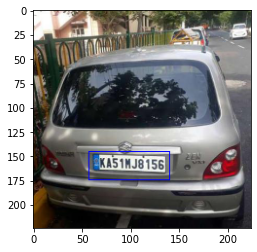

Cropped image ->


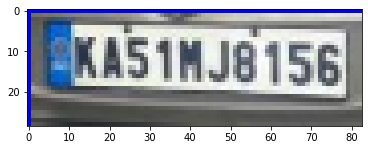

EXA51HI0 156)



0

In [48]:
get_number(5)

Figure 0
Original image with rectangle boundary->


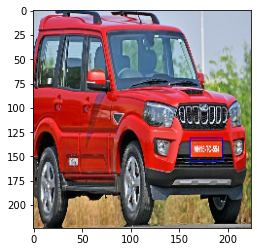

Cropped image ->


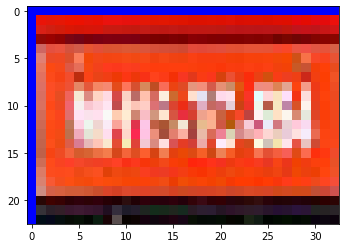

Co

------------------
Figure 1
Original image with rectangle boundary->


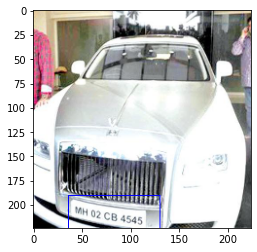

Cropped image ->


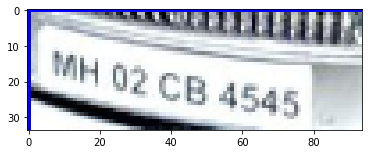


------------------
Figure 2
Original image with rectangle boundary->


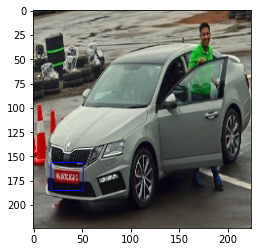

Cropped image ->


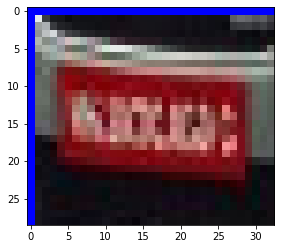

coo

------------------
Figure 3
Original image with rectangle boundary->


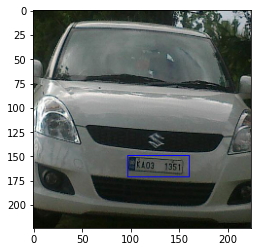

Cropped image ->


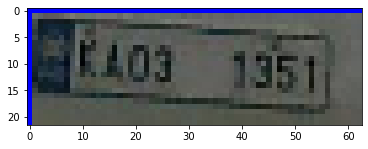


------------------
Figure 4
Original image with rectangle boundary->


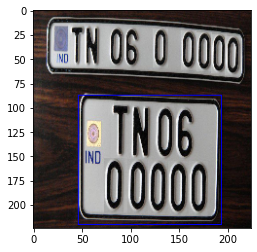

Cropped image ->


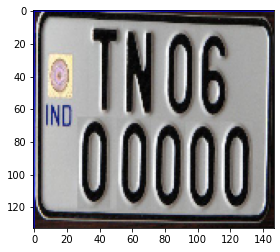

TNOG
| 00000

------------------
Figure 5
Original image with rectangle boundary->


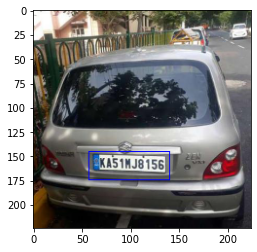

Cropped image ->


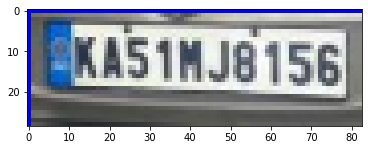

EXA51HI0 156)

------------------
Figure 6
Original image with rectangle boundary->


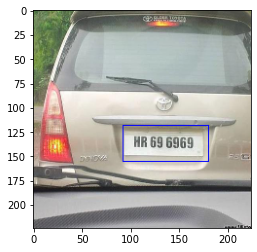

Cropped image ->


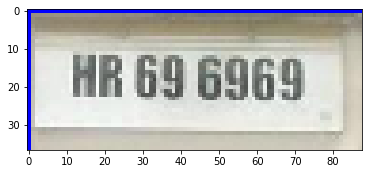

R69 6969

------------------
Figure 7
Original image with rectangle boundary->


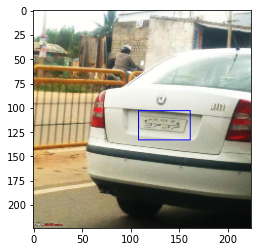

Cropped image ->


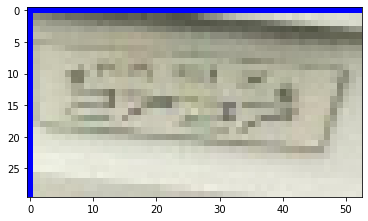


------------------
Figure 8
Original image with rectangle boundary->


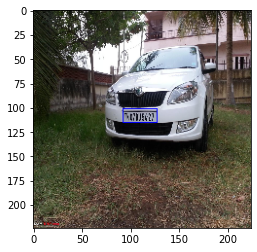

Cropped image ->


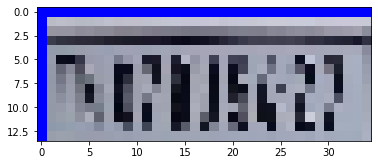


------------------
Figure 9
Original image with rectangle boundary->


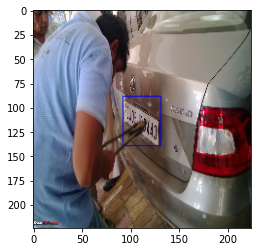

Cropped image ->


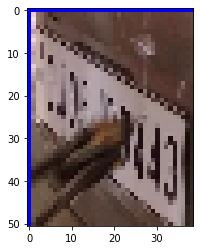

a

------------------
Figure 10
Original image with rectangle boundary->


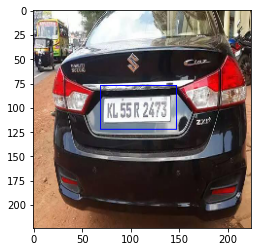

Cropped image ->


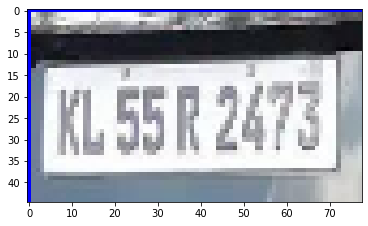


------------------
Figure 11
Original image with rectangle boundary->


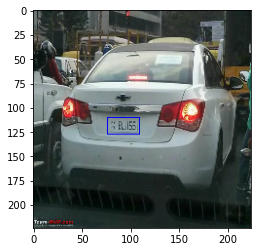

Cropped image ->


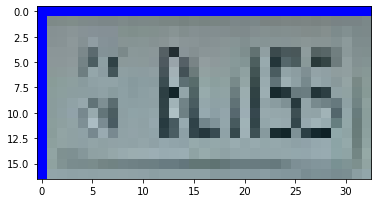

%S BulSS,

------------------
Figure 12
Original image with rectangle boundary->


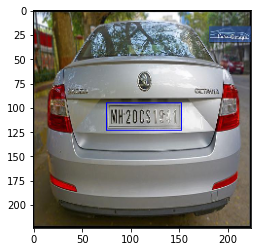

Cropped image ->


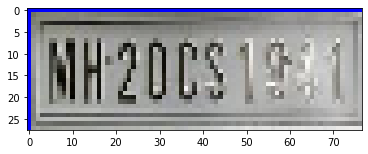


------------------
Figure 13
Original image with rectangle boundary->


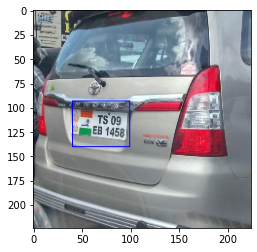

Cropped image ->


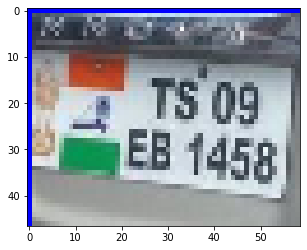

= Ts8
aes ty

------------------
Figure 14
Original image with rectangle boundary->


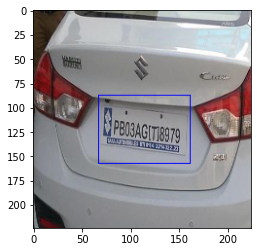

Cropped image ->


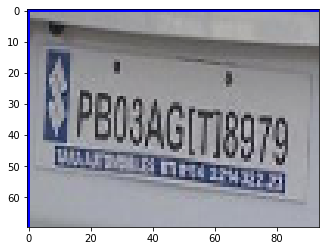

Uses

------------------
Figure 15
Original image with rectangle boundary->


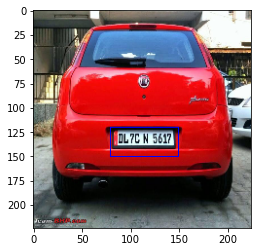

Cropped image ->


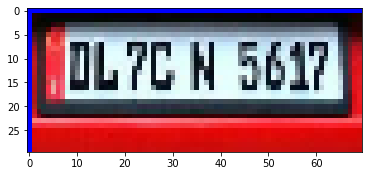

Buu 7C.H 30y7

------------------
Figure 16
Original image with rectangle boundary->


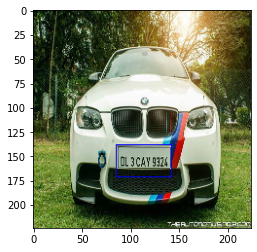

Cropped image ->


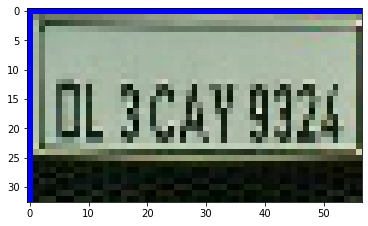

lo ycay se

------------------
Figure 17
Original image with rectangle boundary->


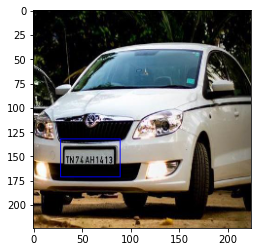

Cropped image ->


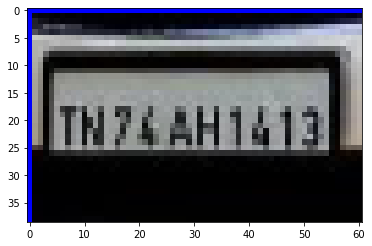


------------------
Figure 18
Original image with rectangle boundary->


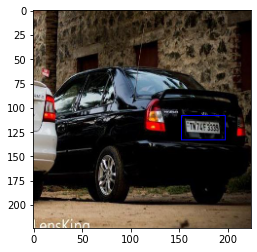

Cropped image ->


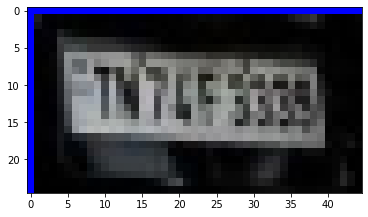

pitta

------------------
Figure 19
Original image with rectangle boundary->


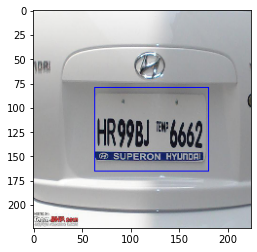

Cropped image ->


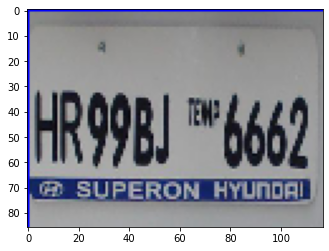

iL

------------------
Figure 20
Original image with rectangle boundary->


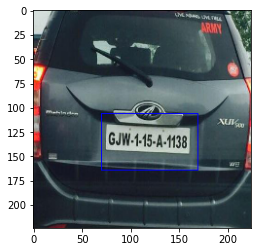

Cropped image ->


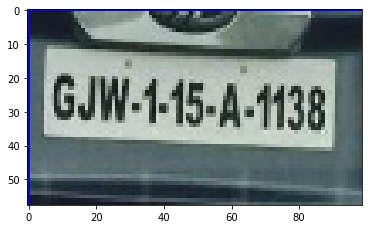

‘ae
GAW-45-A-1198

------------------
Figure 21
Original image with rectangle boundary->


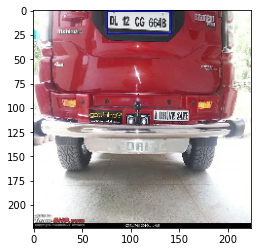

Cropped image ->


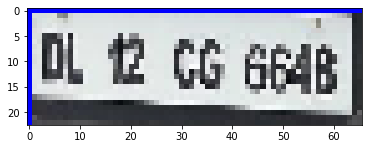

DL #2 6 eo

------------------
Figure 22
Original image with rectangle boundary->


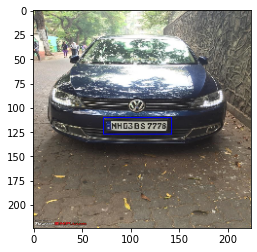

Cropped image ->


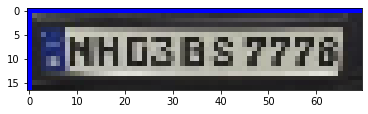

PNHGSES 7776)

------------------
Figure 23
Original image with rectangle boundary->


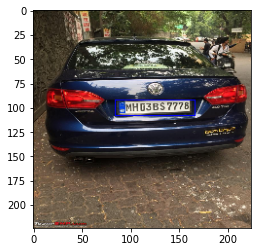

Cropped image ->


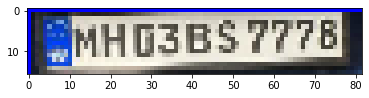

BiH DSCS 77759

------------------
Figure 24
Original image with rectangle boundary->


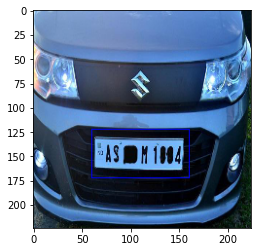

Cropped image ->


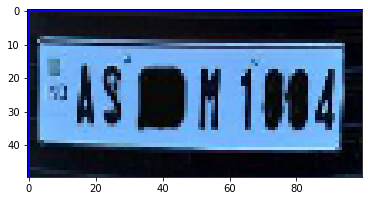

"ic emy cea il

------------------
Figure 25
Original image with rectangle boundary->


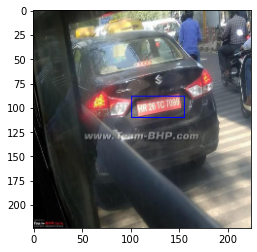

Cropped image ->


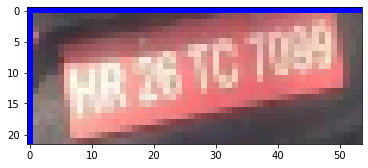

rl

------------------
Figure 26
Original image with rectangle boundary->


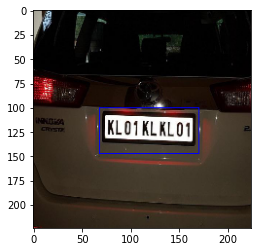

Cropped image ->


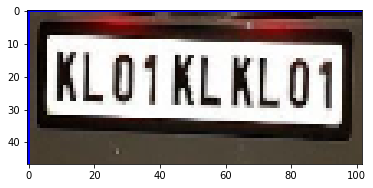

KLOVKLKLON

------------------
Figure 27
Original image with rectangle boundary->


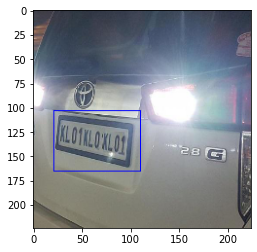

Cropped image ->


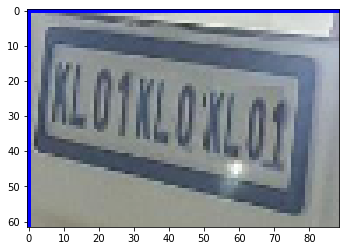

fauceny i

------------------
Figure 28
Original image with rectangle boundary->


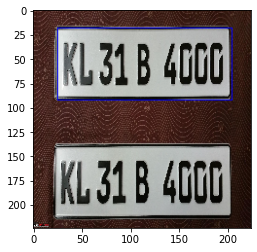

Cropped image ->


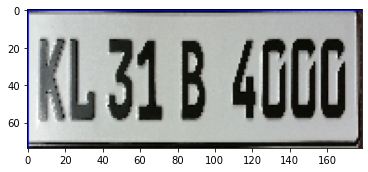

KL31B C00

------------------
Figure 29
Original image with rectangle boundary->


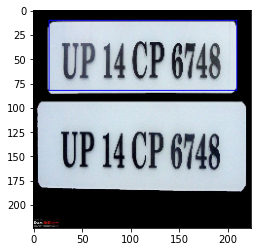

Cropped image ->


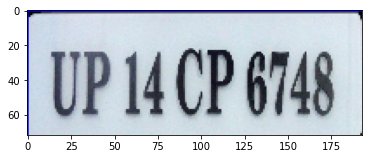

UP 14 CP 6748

------------------
Figure 30
Original image with rectangle boundary->


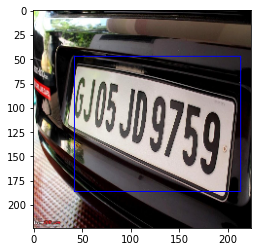

Cropped image ->


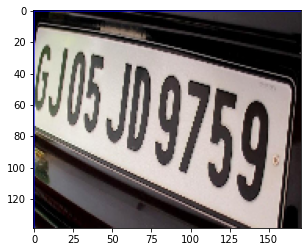

7g

------------------
Figure 31
Original image with rectangle boundary->


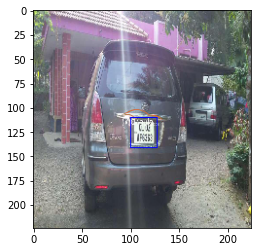

Cropped image ->


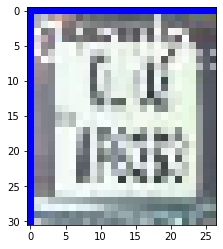


------------------
Figure 32
Original image with rectangle boundary->


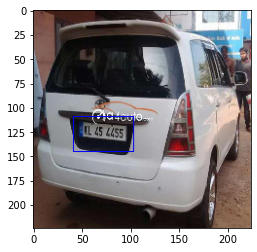

Cropped image ->


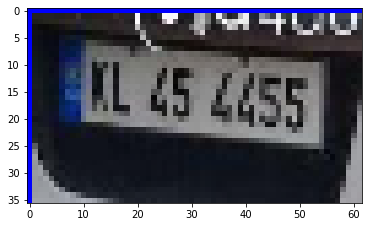

ee
neat

------------------
Figure 33
Original image with rectangle boundary->


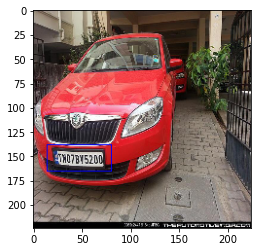

Cropped image ->


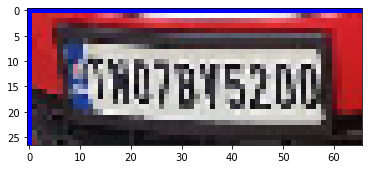

en

------------------
Figure 34
Original image with rectangle boundary->


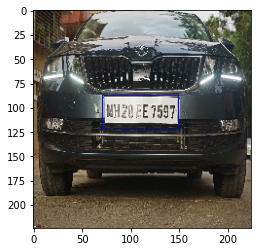

Cropped image ->


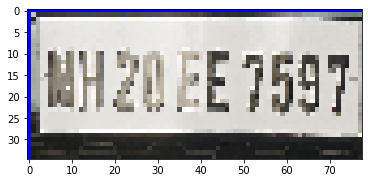

Kites E1597

------------------
Figure 35
Original image with rectangle boundary->


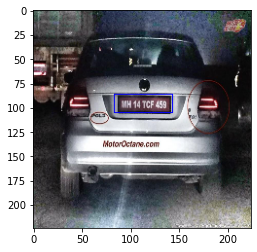

Cropped image ->


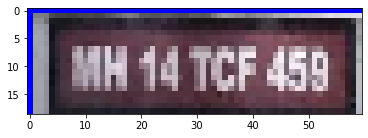

Toned ey

------------------
Figure 36
Original image with rectangle boundary->


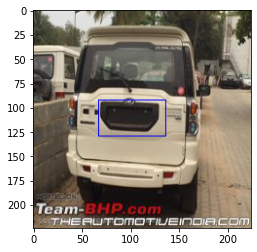

Cropped image ->


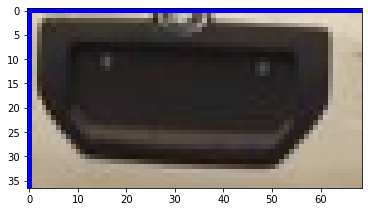

\ J

------------------
Figure 37
Original image with rectangle boundary->


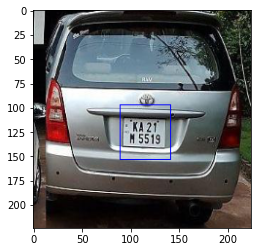

Cropped image ->


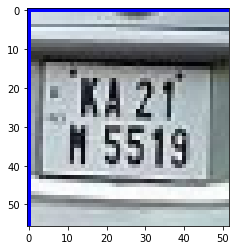

razr fl
N55

------------------
Figure 38
Original image with rectangle boundary->


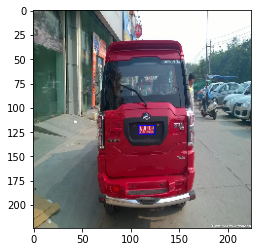

Cropped image ->


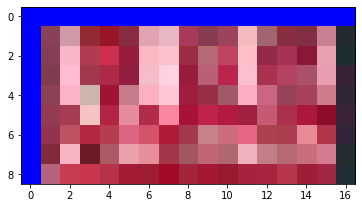


------------------
Figure 39
Original image with rectangle boundary->


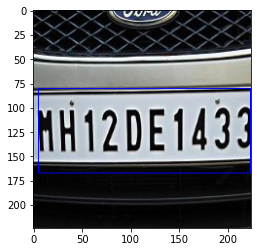

Cropped image ->


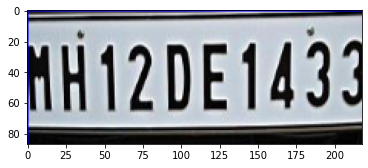

HH12DE 1433

------------------
Figure 40
Original image with rectangle boundary->


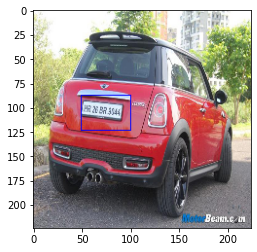

Cropped image ->


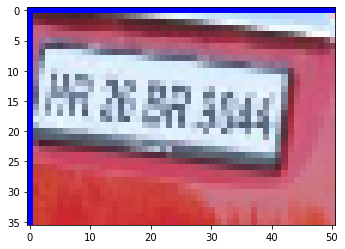

oy

------------------
Figure 41
Original image with rectangle boundary->


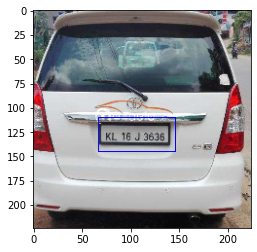

Cropped image ->


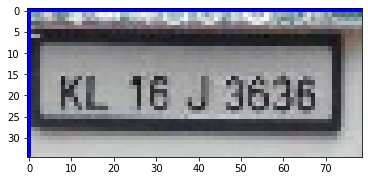

1, 16. 2636,

------------------
Figure 42
Original image with rectangle boundary->


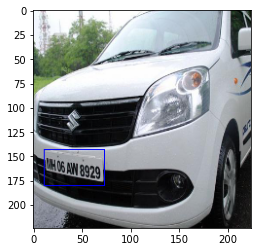

Cropped image ->


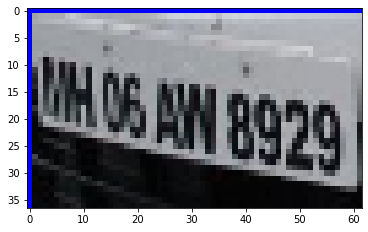

re

------------------
Figure 43
Original image with rectangle boundary->


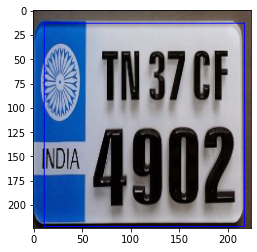

Cropped image ->


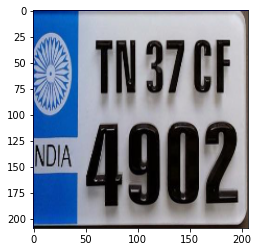

= 4902

------------------
Figure 44
Original image with rectangle boundary->


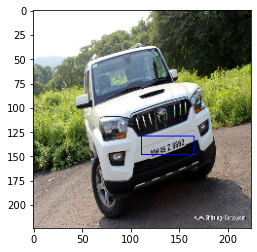

Cropped image ->


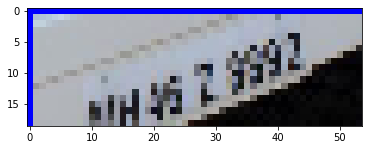

a

------------------
Figure 45
Original image with rectangle boundary->


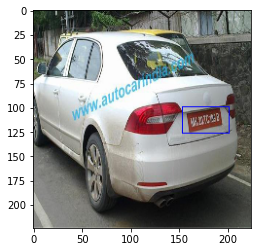

Cropped image ->


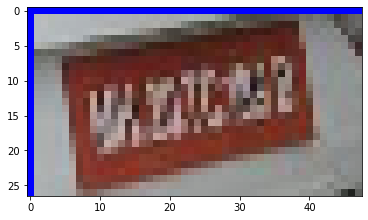


------------------
Figure 46
Original image with rectangle boundary->


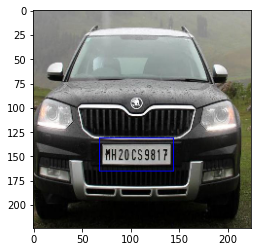

Cropped image ->


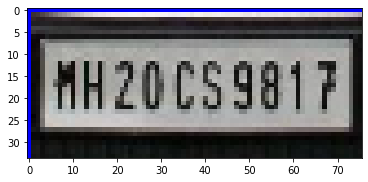

nH 20cs9817}

------------------
Figure 47
Original image with rectangle boundary->


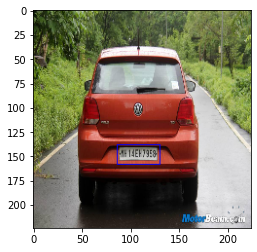

Cropped image ->


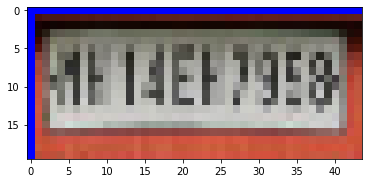

BAPE

------------------
Figure 48
Original image with rectangle boundary->


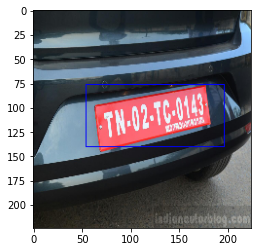

Cropped image ->


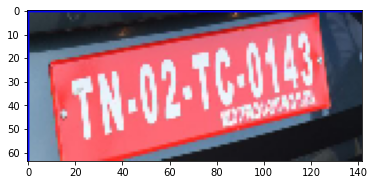


------------------
Figure 49
Original image with rectangle boundary->


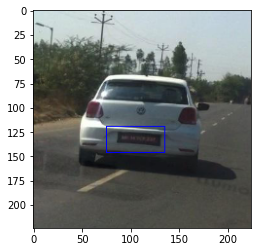

Cropped image ->


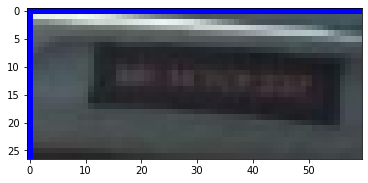


------------------
Figure 50
Original image with rectangle boundary->


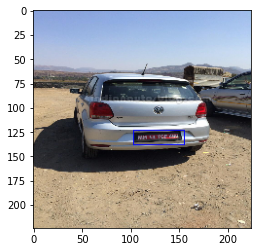

Cropped image ->


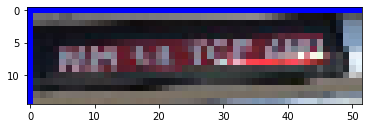


------------------
Figure 51
Original image with rectangle boundary->


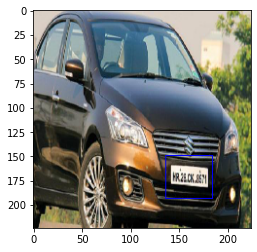

Cropped image ->


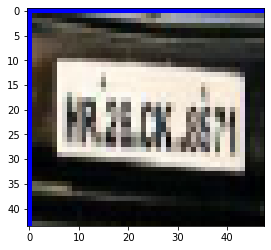


------------------
Figure 52
Original image with rectangle boundary->


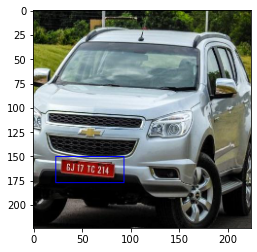

Cropped image ->


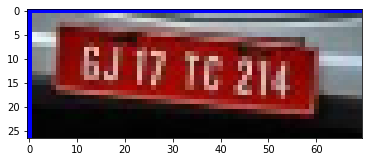

Corr

------------------
Figure 53
Original image with rectangle boundary->


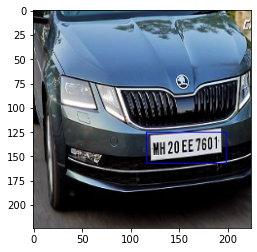

Cropped image ->


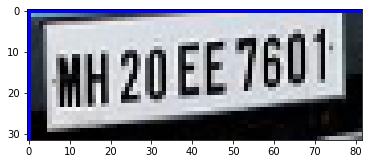


------------------
Figure 54
Original image with rectangle boundary->


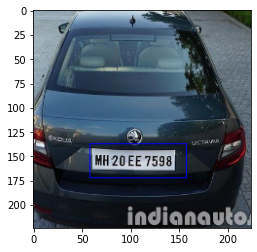

Cropped image ->


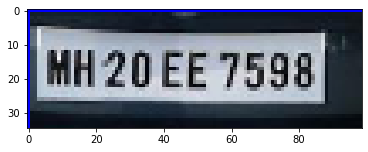

MH 20 EE 7598)

------------------
Figure 55
Original image with rectangle boundary->


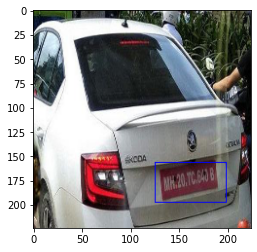

Cropped image ->


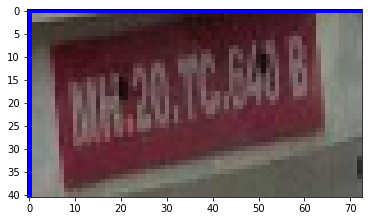

a.

------------------
Figure 56
Original image with rectangle boundary->


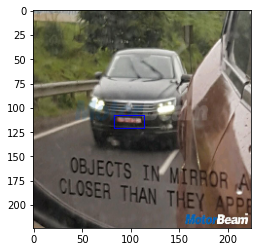

Cropped image ->


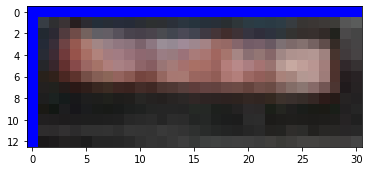


------------------
Figure 57
Original image with rectangle boundary->


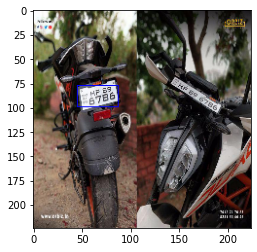

Cropped image ->


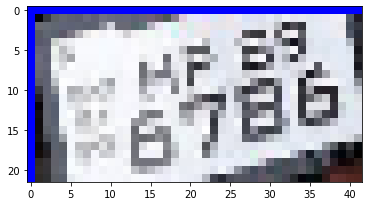


------------------
Figure 58
Original image with rectangle boundary->


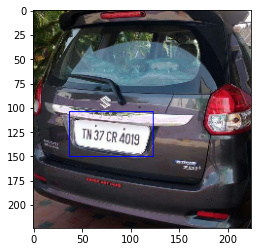

Cropped image ->


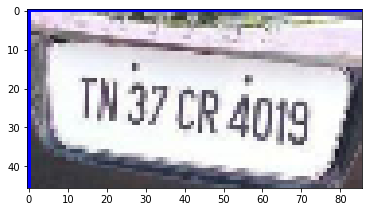

TWa7ce dog ]

------------------
Figure 59
Original image with rectangle boundary->


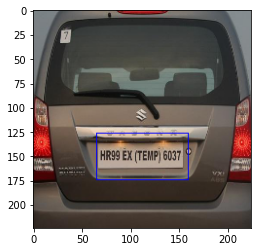

Cropped image ->


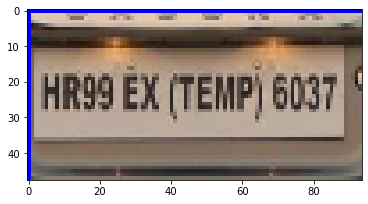

ieee

------------------
Figure 60
Original image with rectangle boundary->


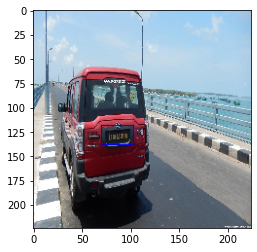

Cropped image ->


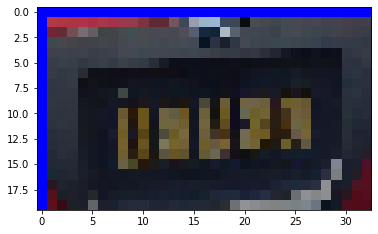


------------------
Figure 61
Original image with rectangle boundary->


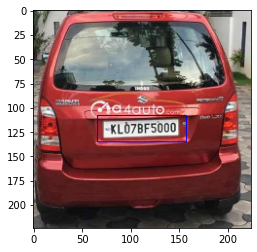

Cropped image ->


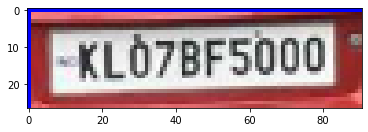

[ x.07BFS000)

------------------
Figure 62
Original image with rectangle boundary->


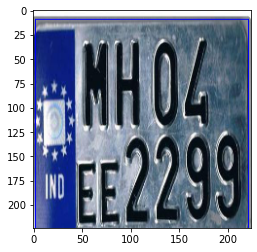

Cropped image ->


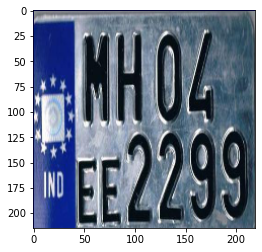

ir | nde
iM FE dae |

------------------
Figure 63
Original image with rectangle boundary->


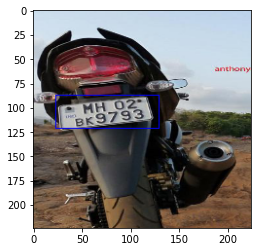

Cropped image ->


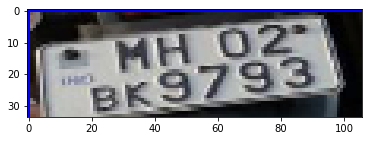

P= Mit OZ,
peo7 33

------------------
Figure 64
Original image with rectangle boundary->


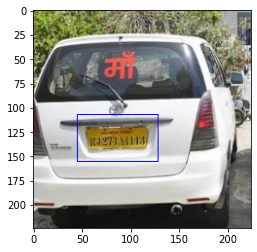

Cropped image ->


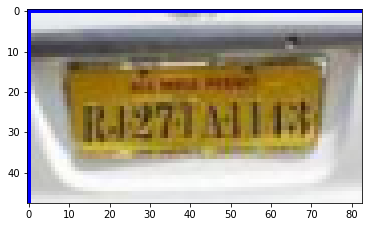

—

------------------
Figure 65
Original image with rectangle boundary->


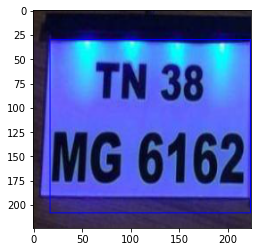

Cropped image ->


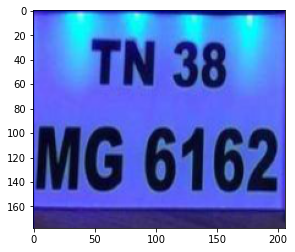

TN 38
MG 6162

------------------
Figure 66
Original image with rectangle boundary->


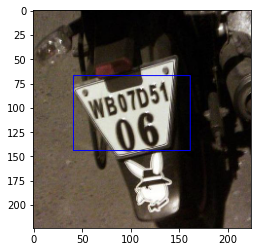

Cropped image ->


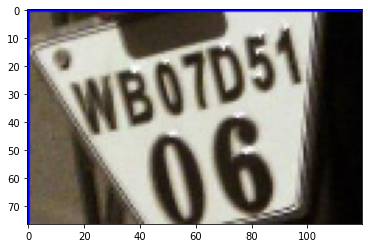

ytd!
NO

------------------
Figure 67
Original image with rectangle boundary->


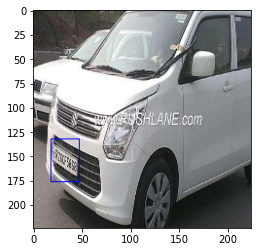

Cropped image ->


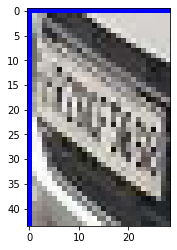


------------------
Figure 68
Original image with rectangle boundary->


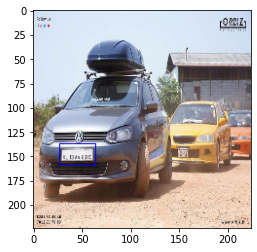

Cropped image ->


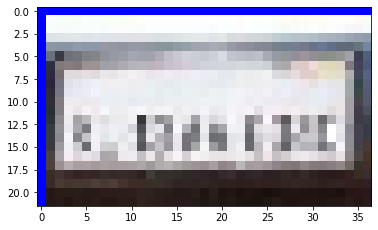


------------------
Figure 69
Original image with rectangle boundary->


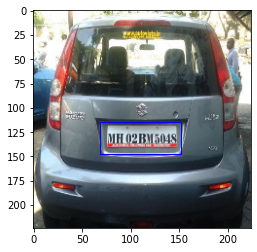

Cropped image ->


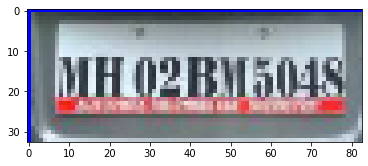

if Han 503g

------------------
Figure 70
Original image with rectangle boundary->


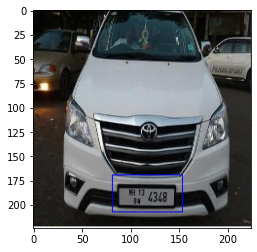

Cropped image ->


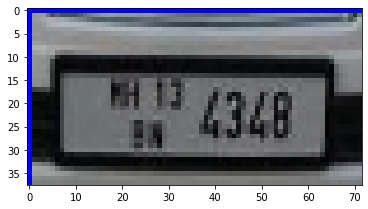

eS

------------------
Figure 71
Original image with rectangle boundary->


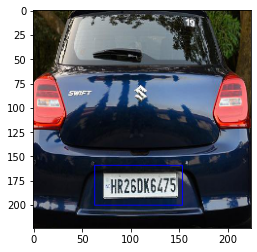

Cropped image ->


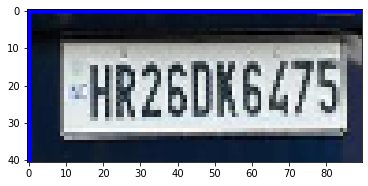

HR26DK6A75

------------------
Figure 72
Original image with rectangle boundary->


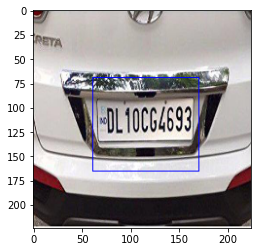

Cropped image ->


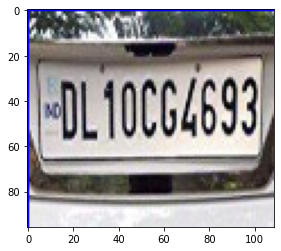

MOL 10064693

------------------
Figure 73
Original image with rectangle boundary->


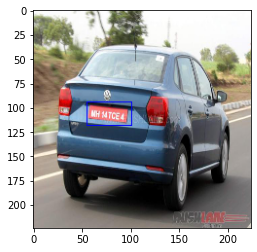

Cropped image ->


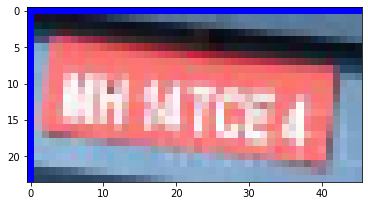

en

------------------
Figure 74
Original image with rectangle boundary->


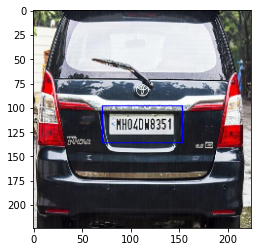

Cropped image ->


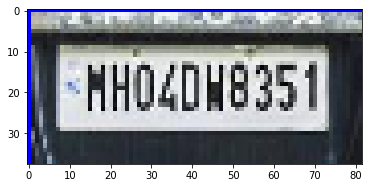

02008351]

------------------
Figure 75
Original image with rectangle boundary->


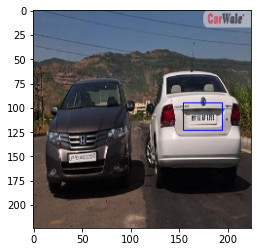

Cropped image ->


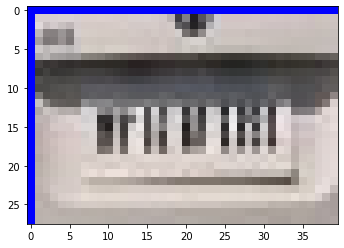

omen

------------------
Figure 76
Original image with rectangle boundary->


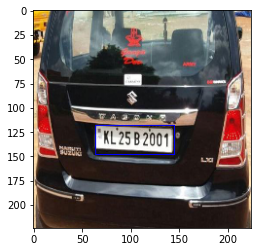

Cropped image ->


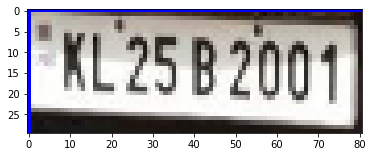

RL 2582001

------------------
Figure 77
Original image with rectangle boundary->


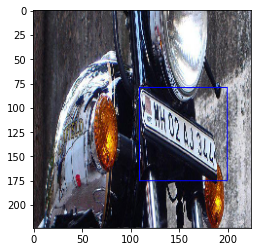

Cropped image ->


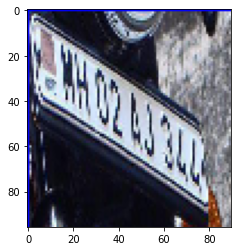

ew
Ne

------------------
Figure 78
Original image with rectangle boundary->


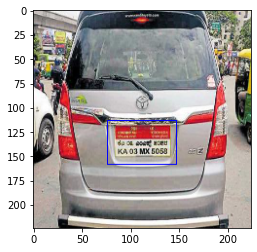

Cropped image ->


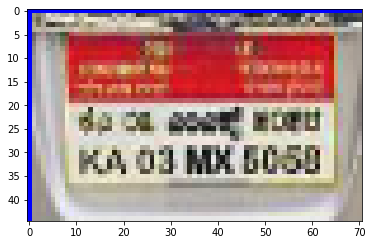


------------------
Figure 79
Original image with rectangle boundary->


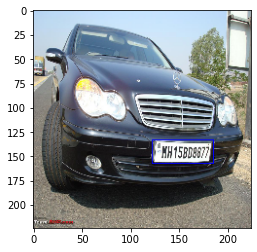

Cropped image ->


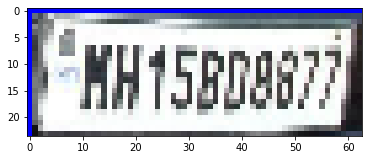

EMH t5B00877

------------------
Figure 80
Original image with rectangle boundary->


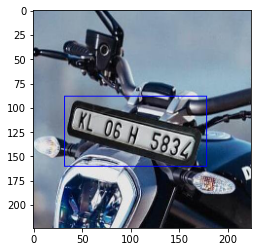

Cropped image ->


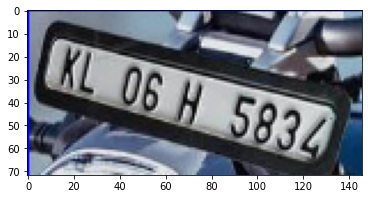


------------------
Figure 81
Original image with rectangle boundary->


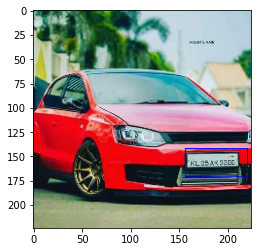

Cropped image ->


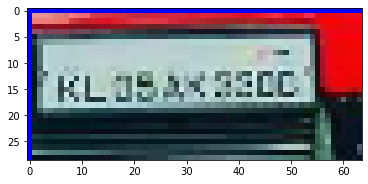


------------------
Figure 82
Original image with rectangle boundary->


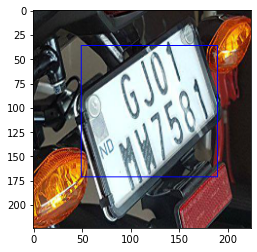

Cropped image ->


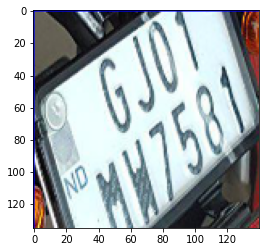

rs |

------------------
Figure 83
Original image with rectangle boundary->


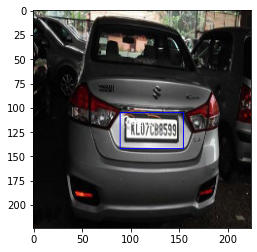

Cropped image ->


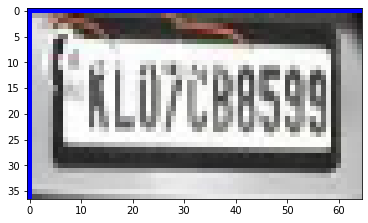

RLILE P54)

------------------
Figure 84
Original image with rectangle boundary->


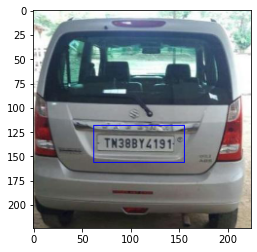

Cropped image ->


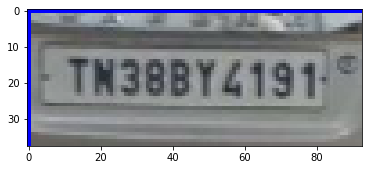

Tusaatesg1-°

------------------
Figure 85
Original image with rectangle boundary->


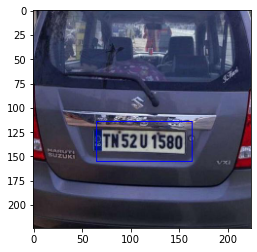

Cropped image ->


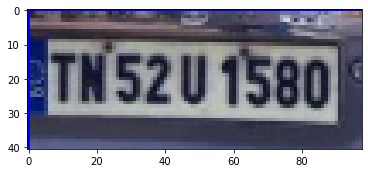

a

------------------
Figure 86
Original image with rectangle boundary->


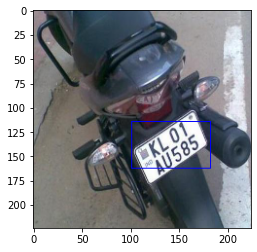

Cropped image ->


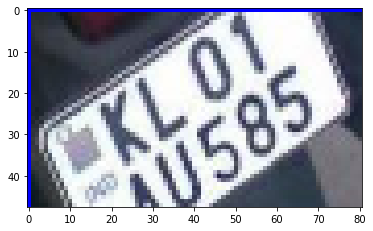

Pag
(0

------------------
Figure 87
Original image with rectangle boundary->


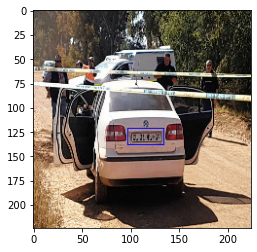

Cropped image ->


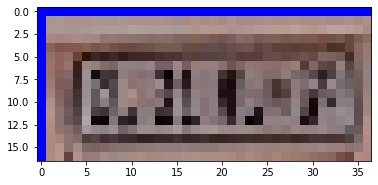

ere

------------------
Figure 88
Original image with rectangle boundary->


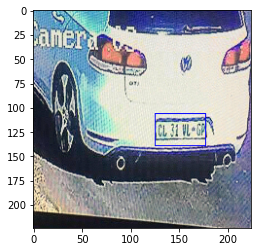

Cropped image ->


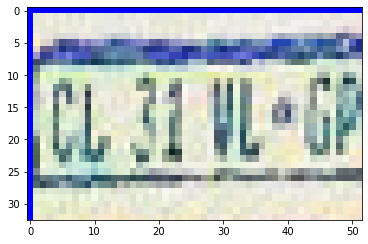


------------------
Figure 89
Original image with rectangle boundary->


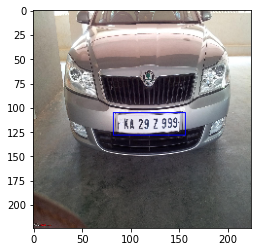

Cropped image ->


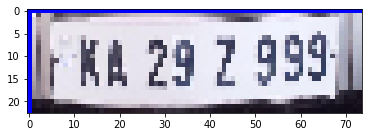

Ir KA 29 2 999.

------------------
Figure 90
Original image with rectangle boundary->


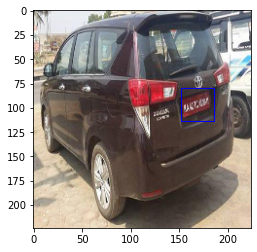

Cropped image ->


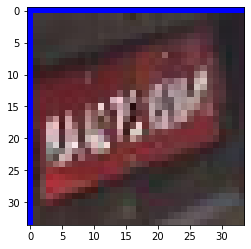

re

------------------
Figure 91
Original image with rectangle boundary->


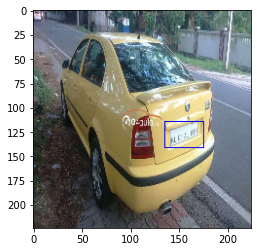

Cropped image ->


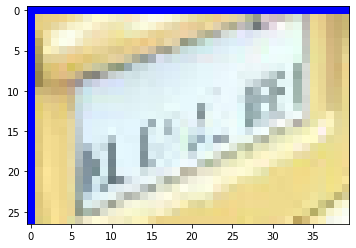

pe

------------------
Figure 92
Original image with rectangle boundary->


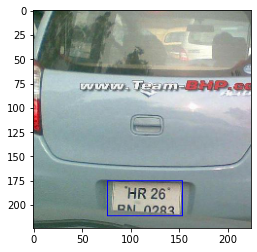

Cropped image ->


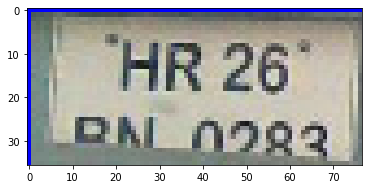

“HR 26° |
“PAL A982 |

------------------
Figure 93
Original image with rectangle boundary->


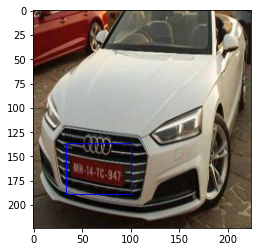

Cropped image ->


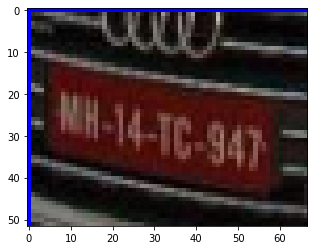


------------------
Figure 94
Original image with rectangle boundary->


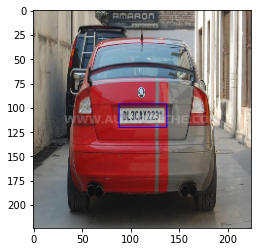

Cropped image ->


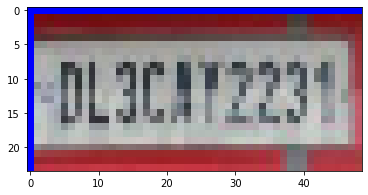

TI

------------------
Figure 95
Original image with rectangle boundary->


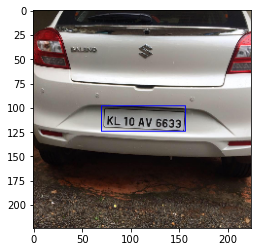

Cropped image ->


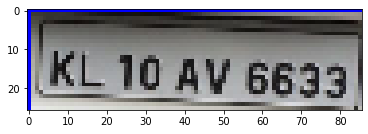

KL IOAY 8693)

------------------
Figure 96
Original image with rectangle boundary->


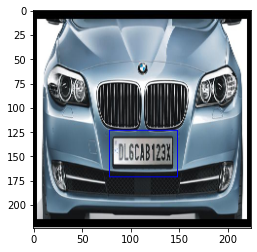

Cropped image ->


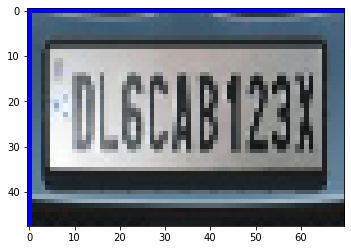

SLSDAB 23h

------------------
Figure 97
Original image with rectangle boundary->


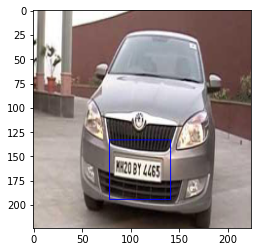

Cropped image ->


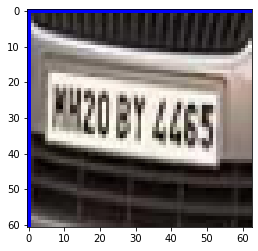

i

------------------
Figure 98
Original image with rectangle boundary->


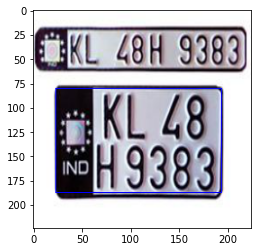

Cropped image ->


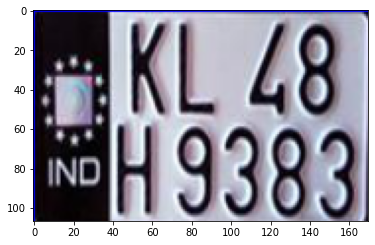

es 48
H 9383

------------------
Figure 99
Original image with rectangle boundary->


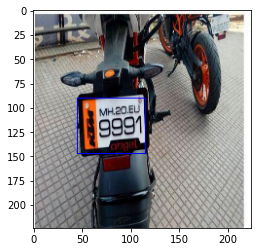

Cropped image ->


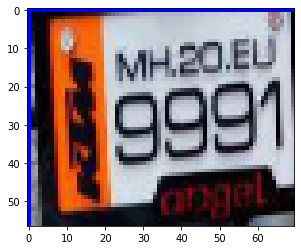

msc!

------------------
Figure 100
Original image with rectangle boundary->


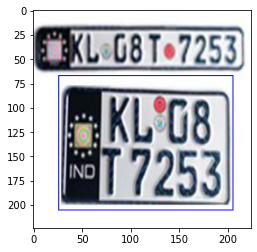

Cropped image ->


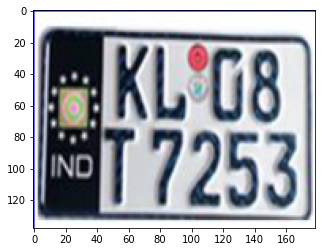

ne
7253

------------------
Figure 101
Original image with rectangle boundary->


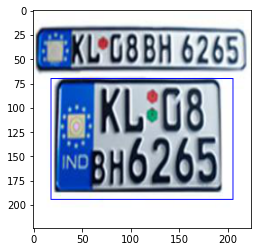

Cropped image ->


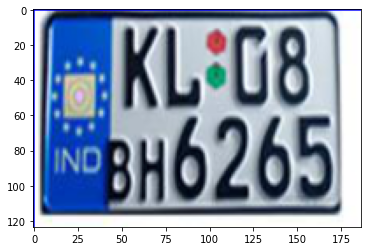

aye
46265

------------------
Figure 102
Original image with rectangle boundary->


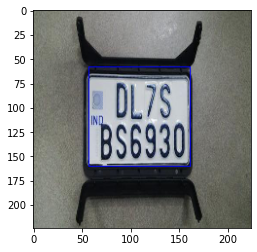

Cropped image ->


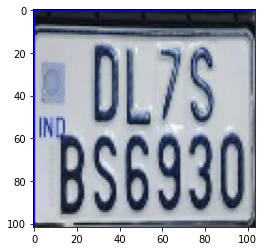

, DLIS
896930

------------------
Figure 103
Original image with rectangle boundary->


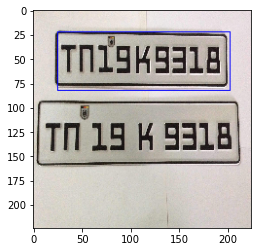

Cropped image ->


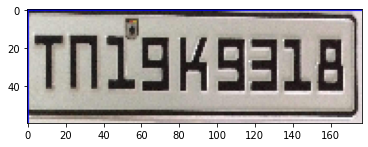

TNTSKSS18

------------------
Figure 104
Original image with rectangle boundary->


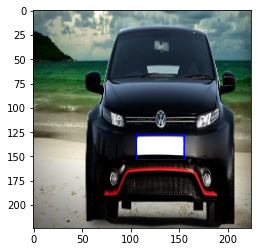

Cropped image ->


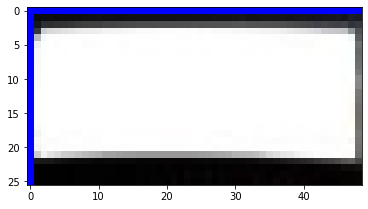

pe

------------------
Figure 105
Original image with rectangle boundary->


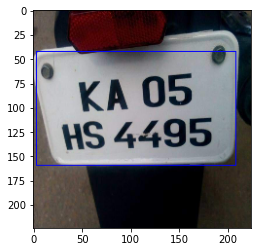

Cropped image ->


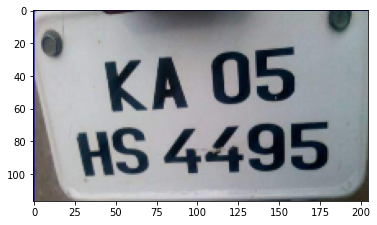

* KA 05
WS 4495

------------------
Figure 106
Original image with rectangle boundary->


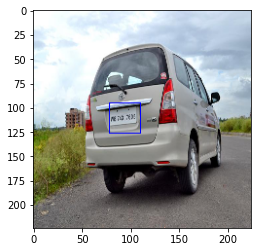

Cropped image ->


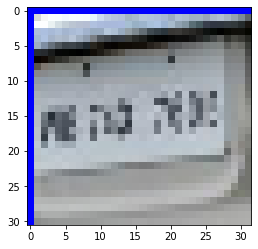


------------------
Figure 107
Original image with rectangle boundary->


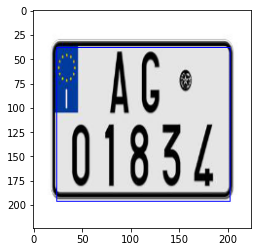

Cropped image ->


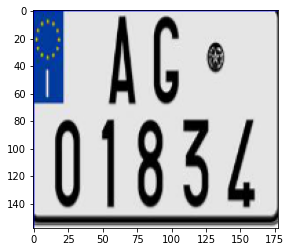

DIES.

------------------
Figure 108
Original image with rectangle boundary->


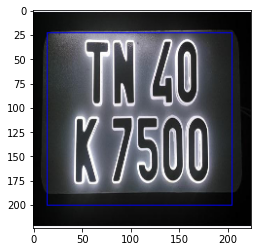

Cropped image ->


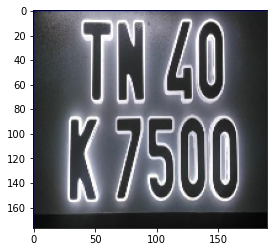

i

------------------
Figure 109
Original image with rectangle boundary->


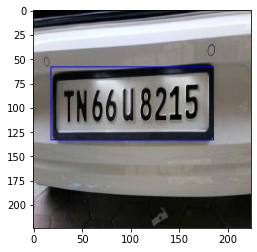

Cropped image ->


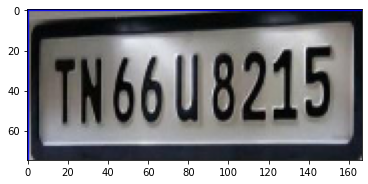

hss us215

------------------
Figure 110
Original image with rectangle boundary->


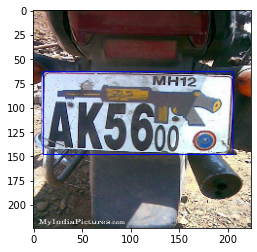

Cropped image ->


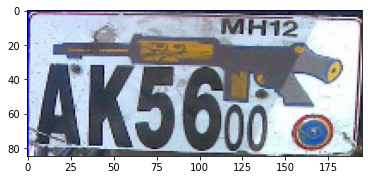


------------------
Figure 111
Original image with rectangle boundary->


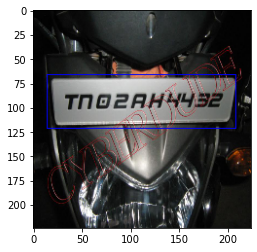

Cropped image ->


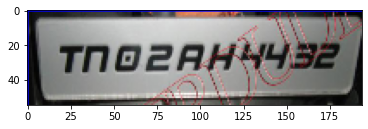

BANS

------------------
Figure 112
Original image with rectangle boundary->


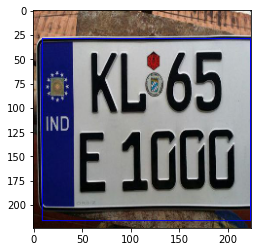

Cropped image ->


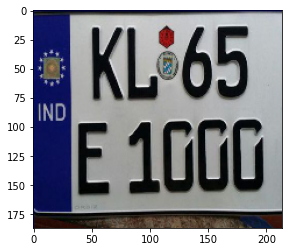

KL#65
E 1000

------------------
Figure 113
Original image with rectangle boundary->


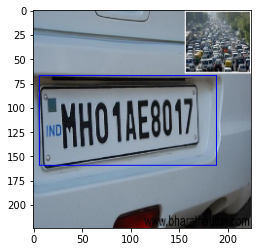

Cropped image ->


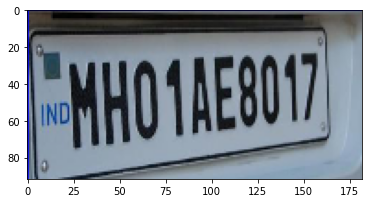

NOAA

------------------
Figure 114
Original image with rectangle boundary->


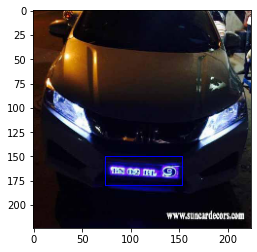

Cropped image ->


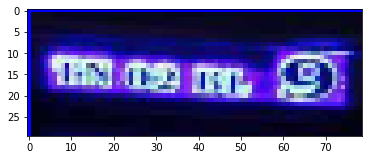

mem G

------------------
Figure 115
Original image with rectangle boundary->


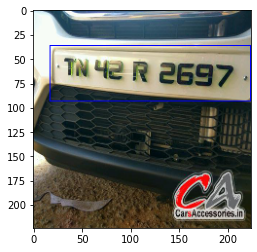

Cropped image ->


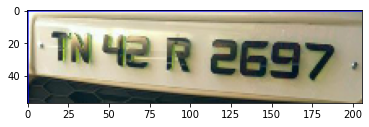

Th 42 R OES?

------------------
Figure 116
Original image with rectangle boundary->


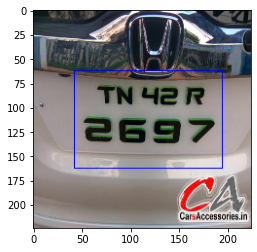

Cropped image ->


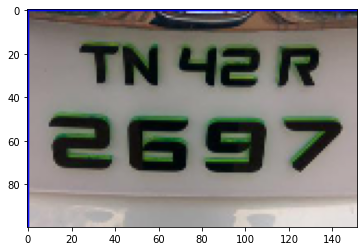


------------------
Figure 117
Original image with rectangle boundary->


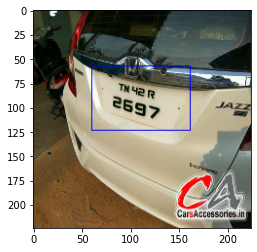

Cropped image ->


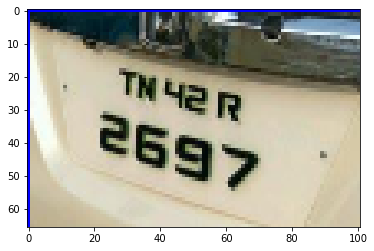

AN :
®Bgy

------------------
Figure 118
Original image with rectangle boundary->


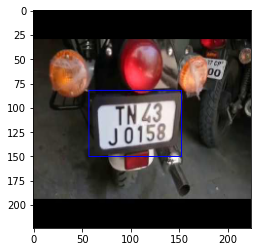

Cropped image ->


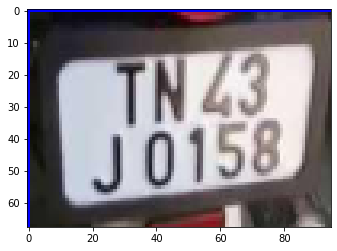


------------------
Figure 119
Original image with rectangle boundary->


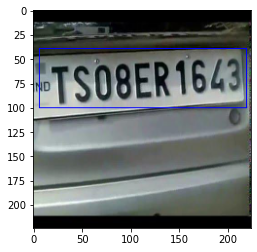

Cropped image ->


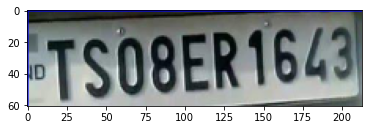


------------------
Figure 120
Original image with rectangle boundary->


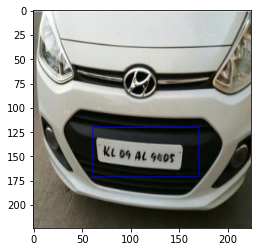

Cropped image ->


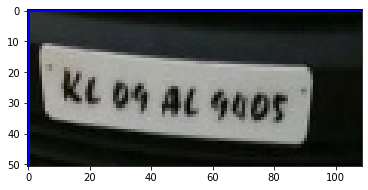

Camry

------------------
Figure 121
Original image with rectangle boundary->


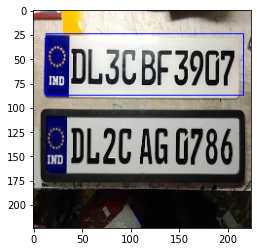

Cropped image ->


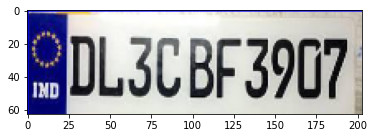

EDL3CBF3907

------------------
Figure 122
Original image with rectangle boundary->


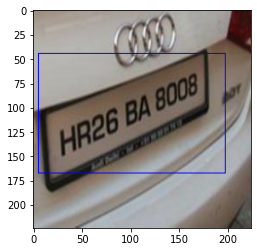

Cropped image ->


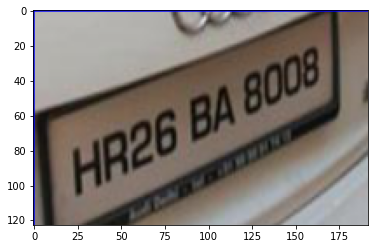

—

------------------
Figure 123
Original image with rectangle boundary->


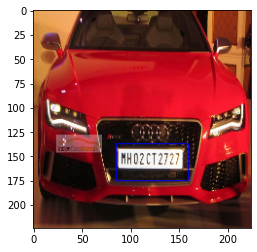

Cropped image ->


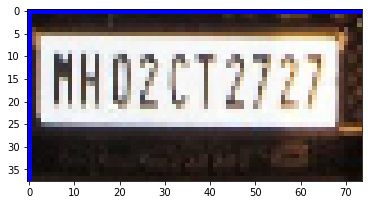

noes]

------------------
Figure 124
Original image with rectangle boundary->


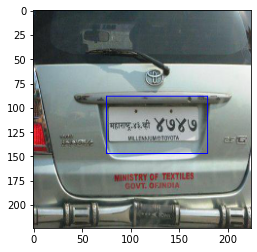

Cropped image ->


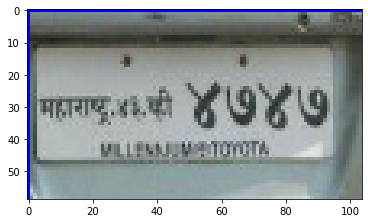

Pee xses}

------------------
Figure 125
Original image with rectangle boundary->


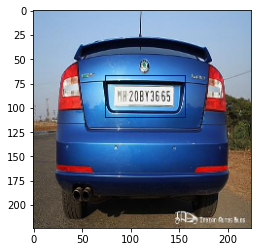

Cropped image ->


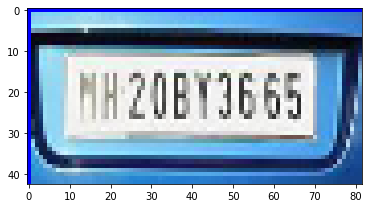

ENTE

------------------
Figure 126
Original image with rectangle boundary->


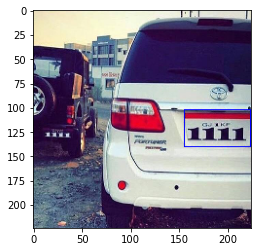

Cropped image ->


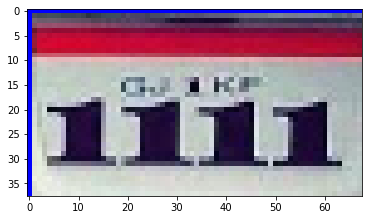

Phone

------------------
Figure 127
Original image with rectangle boundary->


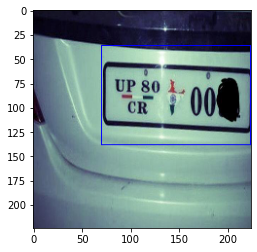

Cropped image ->


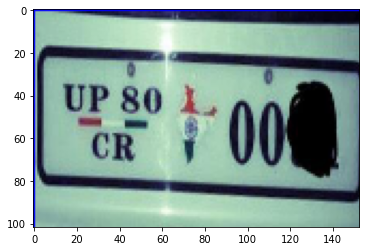

Pl

------------------
Figure 128
Original image with rectangle boundary->


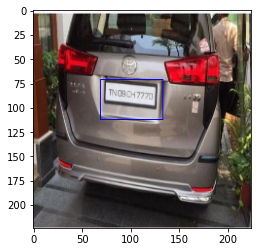

Cropped image ->


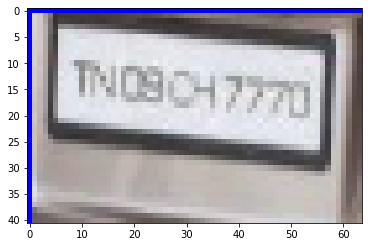

J

------------------
Figure 129
Original image with rectangle boundary->


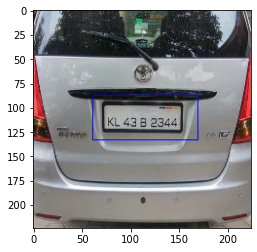

Cropped image ->


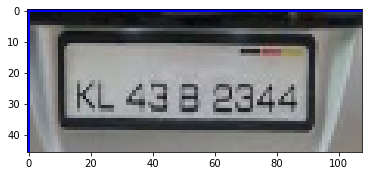

ku aaa 2344]

------------------
Figure 130
Original image with rectangle boundary->


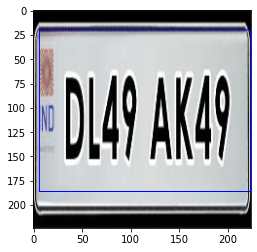

Cropped image ->


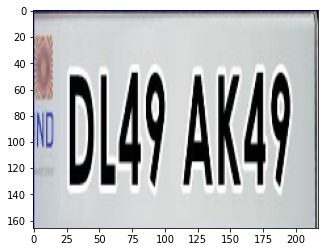


------------------
Figure 131
Original image with rectangle boundary->


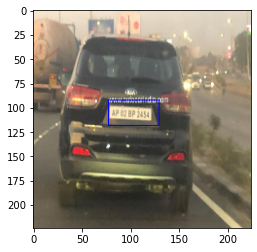

Cropped image ->


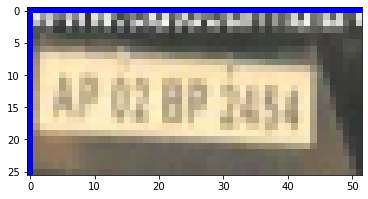


------------------
Figure 132
Original image with rectangle boundary->


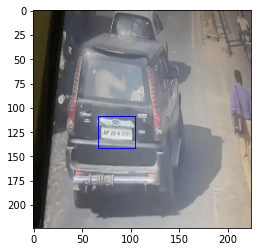

Cropped image ->


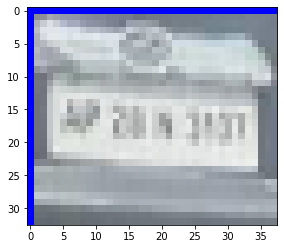

pt

------------------
Figure 133
Original image with rectangle boundary->


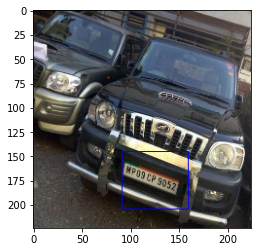

Cropped image ->


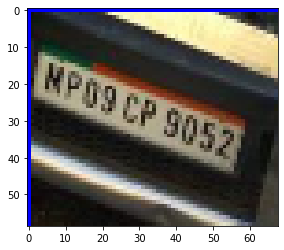

a.
ma

------------------
Figure 134
Original image with rectangle boundary->


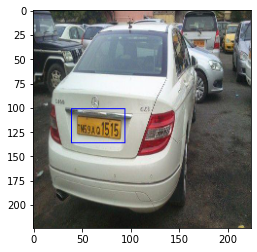

Cropped image ->


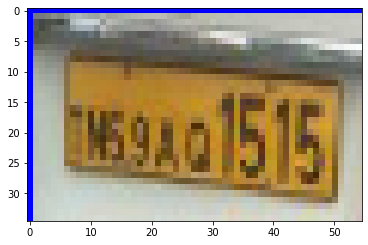


------------------
Figure 135
Original image with rectangle boundary->


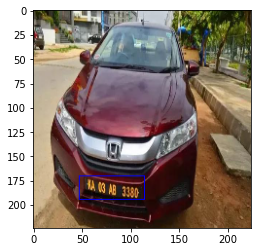

Cropped image ->


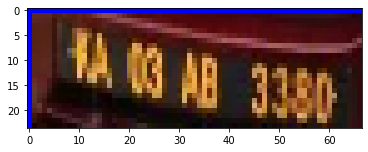

Ce Ee

------------------
Figure 136
Original image with rectangle boundary->


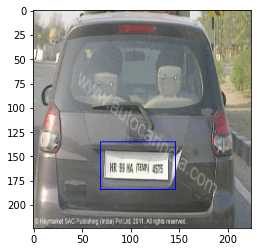

Cropped image ->


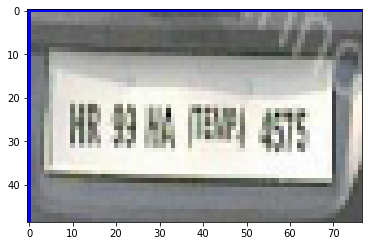


------------------
Figure 137
Original image with rectangle boundary->


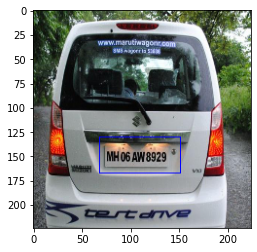

Cropped image ->


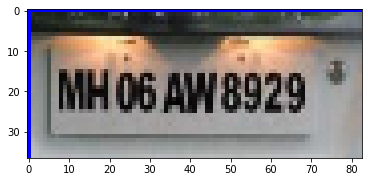


------------------
Figure 138
Original image with rectangle boundary->


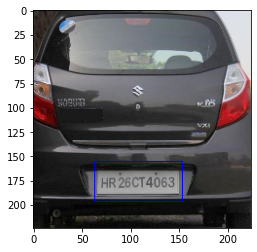

Cropped image ->


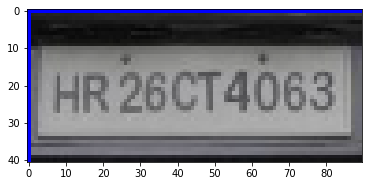

HR 26CT4063

------------------
Figure 139
Original image with rectangle boundary->


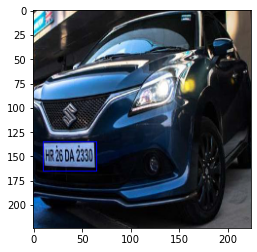

Cropped image ->


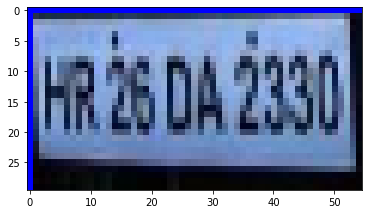

pate 30

------------------
Figure 140
Original image with rectangle boundary->


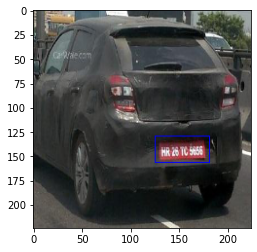

Cropped image ->


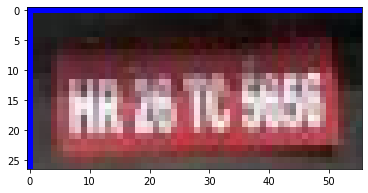

rr

------------------
Figure 141
Original image with rectangle boundary->


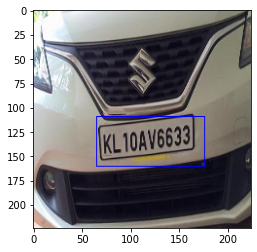

Cropped image ->


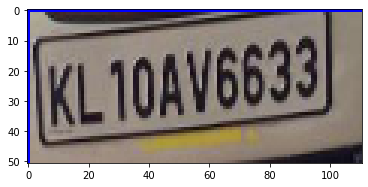

1048823
tonnes

------------------
Figure 142
Original image with rectangle boundary->


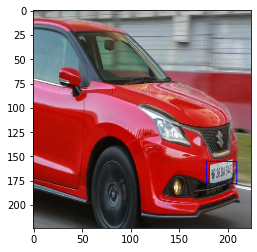

Cropped image ->


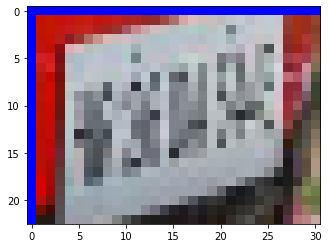


------------------
Figure 143
Original image with rectangle boundary->


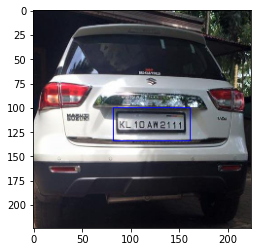

Cropped image ->


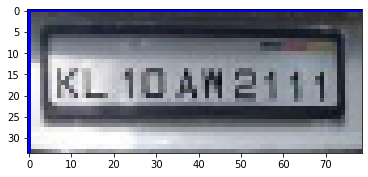

crognarss]

------------------
Figure 144
Original image with rectangle boundary->


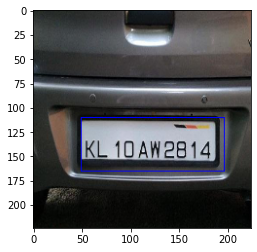

Cropped image ->


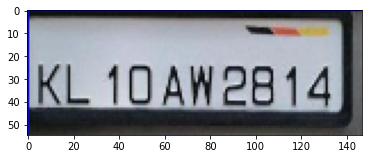

KL IO AW2814

------------------
Figure 145
Original image with rectangle boundary->


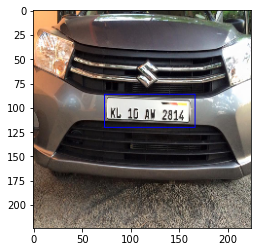

Cropped image ->


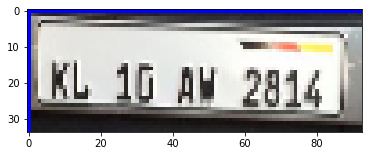

kL 5 W286

------------------
Figure 146
Original image with rectangle boundary->


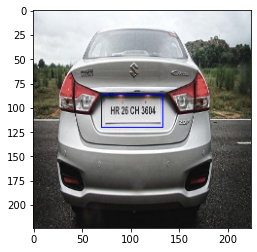

Cropped image ->


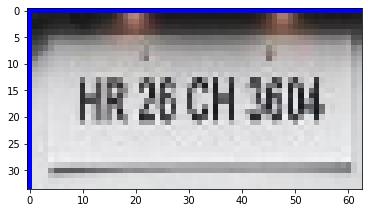

vac ae

------------------
Figure 147
Original image with rectangle boundary->


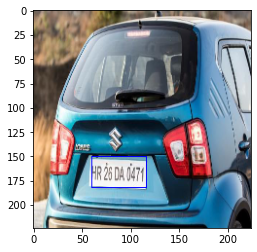

Cropped image ->


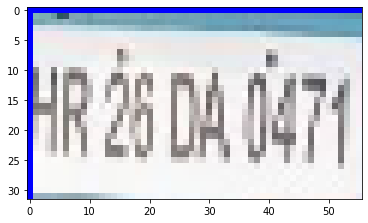


------------------
Figure 148
Original image with rectangle boundary->


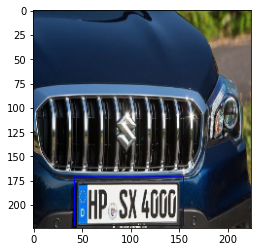

Cropped image ->


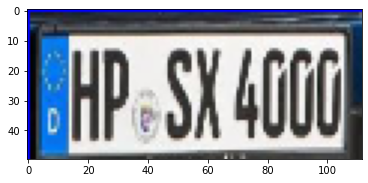


------------------
Figure 149
Original image with rectangle boundary->


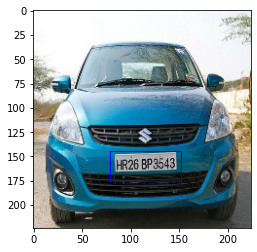

Cropped image ->


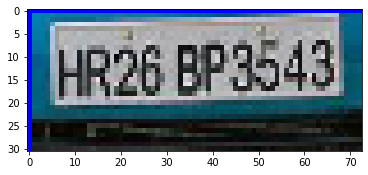

{6 63543)

------------------
Figure 150
Original image with rectangle boundary->


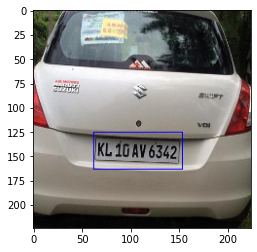

Cropped image ->


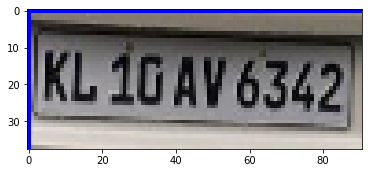


------------------
Figure 151
Original image with rectangle boundary->


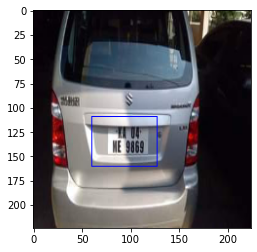

Cropped image ->


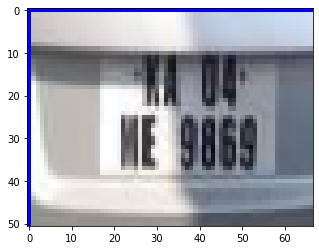


------------------
Figure 152
Original image with rectangle boundary->


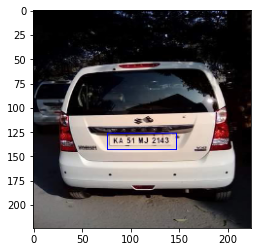

Cropped image ->


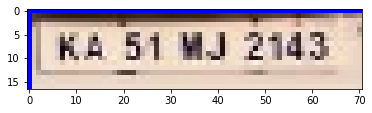


------------------
Figure 153
Original image with rectangle boundary->


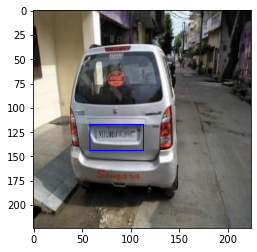

Cropped image ->


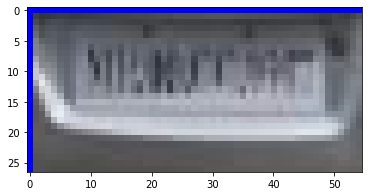

alia

------------------
Figure 154
Original image with rectangle boundary->


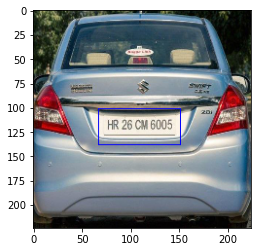

Cropped image ->


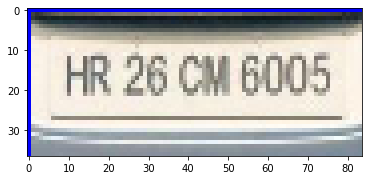

HE 26 OV a

------------------
Figure 155
Original image with rectangle boundary->


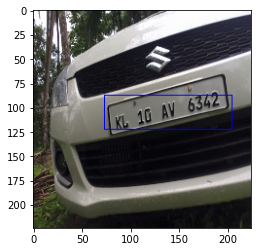

Cropped image ->


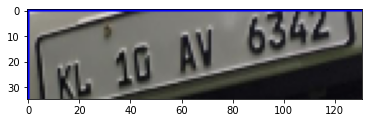


------------------
Figure 156
Original image with rectangle boundary->


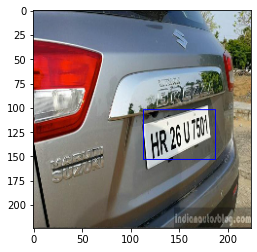

Cropped image ->


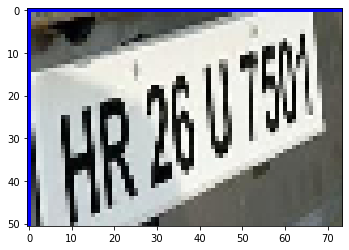


------------------
Figure 157
Original image with rectangle boundary->


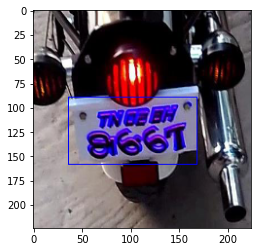

Cropped image ->


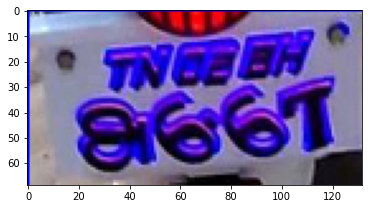


------------------
Figure 158
Original image with rectangle boundary->


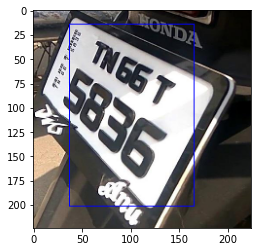

Cropped image ->


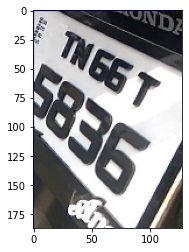


------------------
Figure 159
Original image with rectangle boundary->


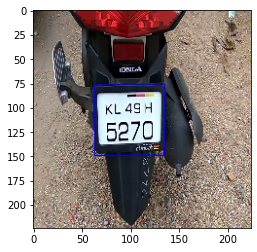

Cropped image ->


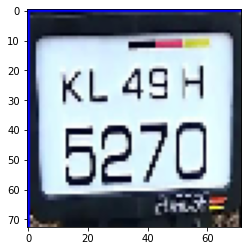

5270]

------------------
Figure 160
Original image with rectangle boundary->


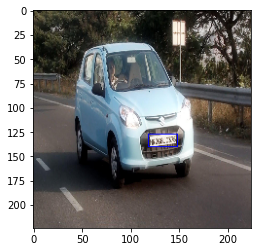

Cropped image ->


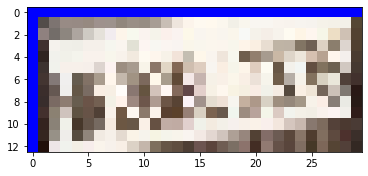

by it -5

------------------
Figure 161
Original image with rectangle boundary->


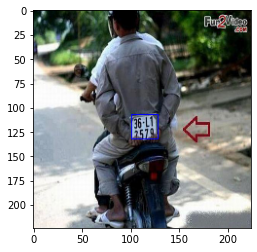

Cropped image ->


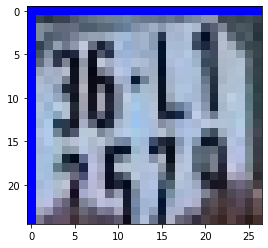

ae LY

------------------
Figure 162
Original image with rectangle boundary->


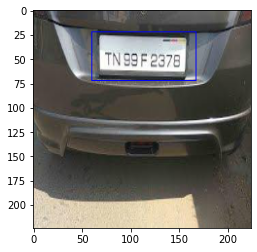

Cropped image ->


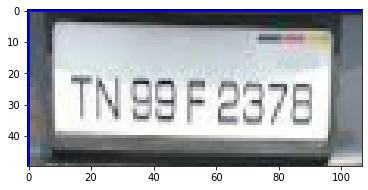


------------------
Figure 163
Original image with rectangle boundary->


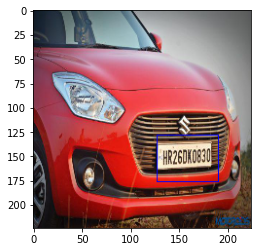

Cropped image ->


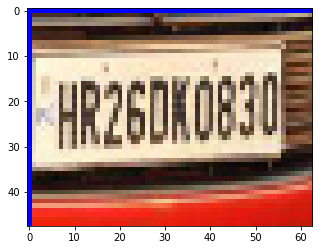


------------------
Figure 164
Original image with rectangle boundary->


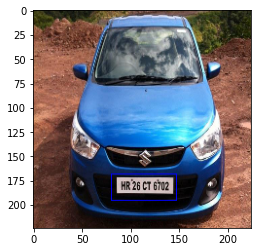

Cropped image ->


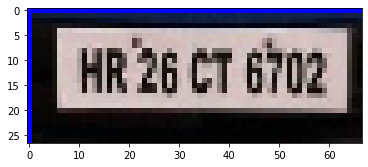

R26 CT BHO

------------------
Figure 165
Original image with rectangle boundary->


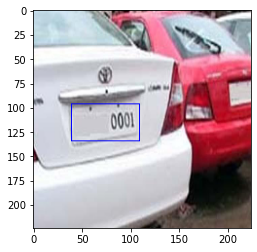

Cropped image ->


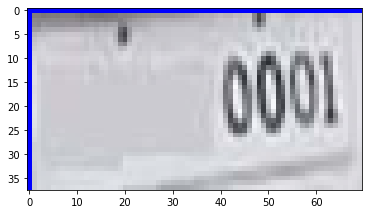

“gga

------------------
Figure 166
Original image with rectangle boundary->


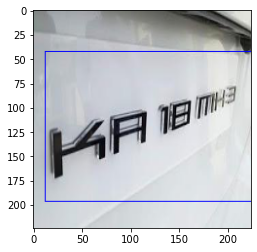

Cropped image ->


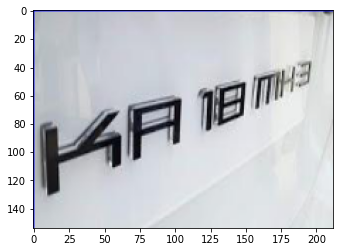

YAR pr

------------------
Figure 167
Original image with rectangle boundary->


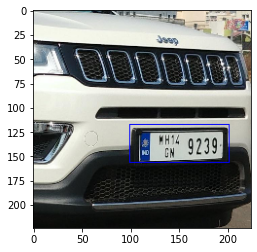

Cropped image ->


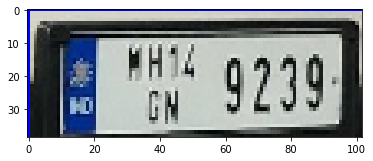

ERED

------------------
Figure 168
Original image with rectangle boundary->


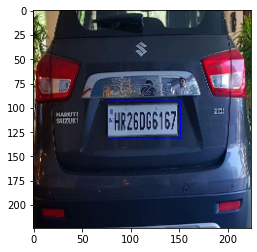

Cropped image ->


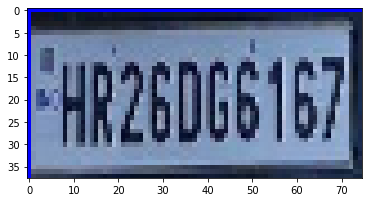

HR26066467

------------------
Figure 169
Original image with rectangle boundary->


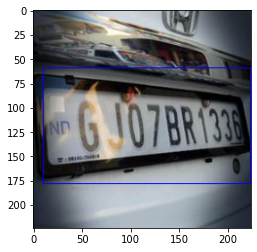

Cropped image ->


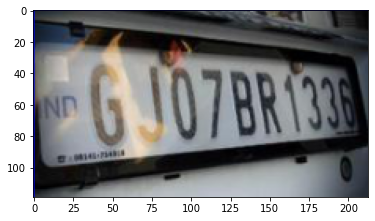

“6 WS
————eEE——

------------------
Figure 170
Original image with rectangle boundary->


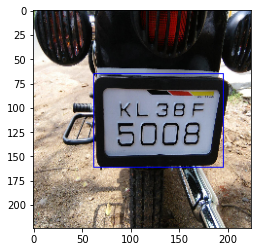

Cropped image ->


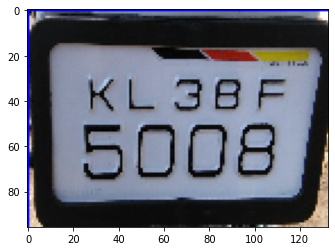

i KLaeF
20008

------------------
Figure 171
Original image with rectangle boundary->


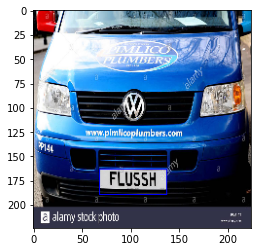

Cropped image ->


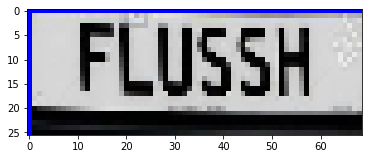

FLUSSH

------------------
Figure 172
Original image with rectangle boundary->


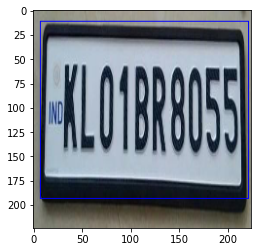

Cropped image ->


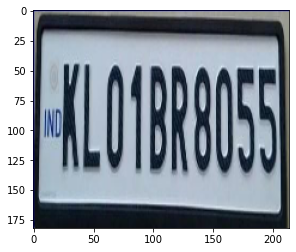


------------------
Figure 173
Original image with rectangle boundary->


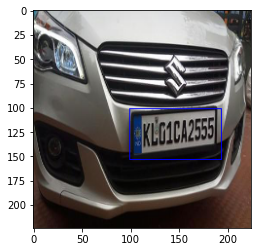

Cropped image ->


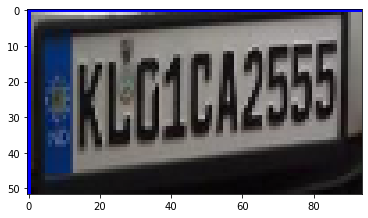


------------------
Figure 174
Original image with rectangle boundary->


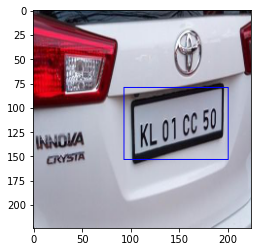

Cropped image ->


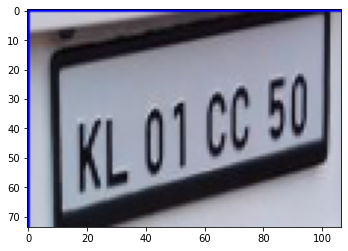


------------------
Figure 175
Original image with rectangle boundary->


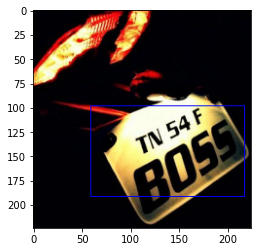

Cropped image ->


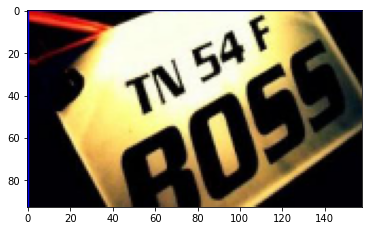


------------------
Figure 176
Original image with rectangle boundary->


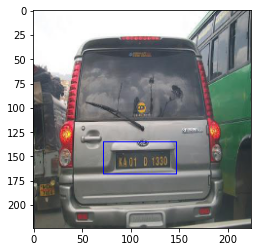

Cropped image ->


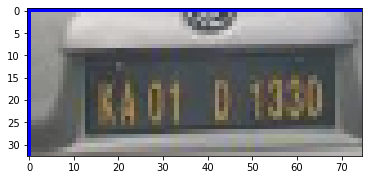


------------------
Figure 177
Original image with rectangle boundary->


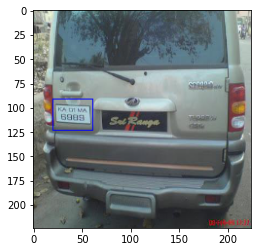

Cropped image ->


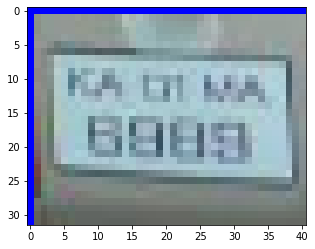


------------------
Figure 178
Original image with rectangle boundary->


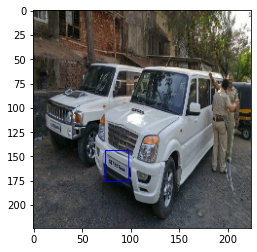

Cropped image ->


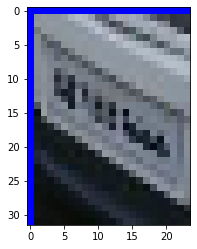

S

------------------
Figure 179
Original image with rectangle boundary->


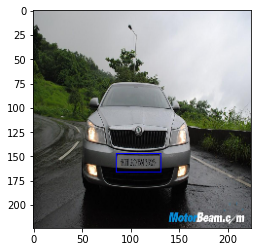

Cropped image ->


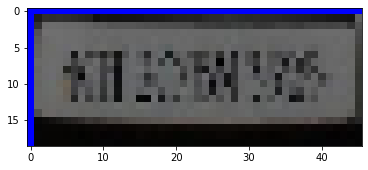


------------------
Figure 180
Original image with rectangle boundary->


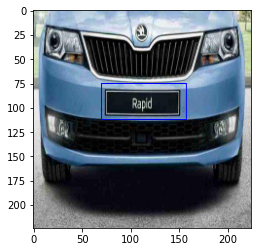

Cropped image ->


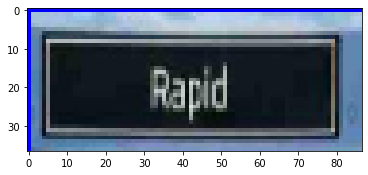

a.

------------------
Figure 181
Original image with rectangle boundary->


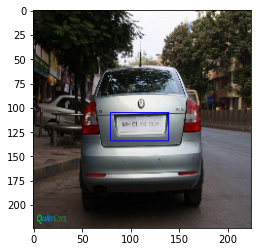

Cropped image ->


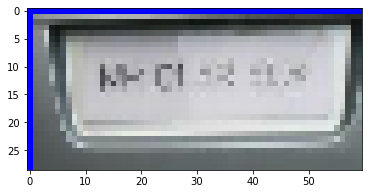


------------------
Figure 182
Original image with rectangle boundary->


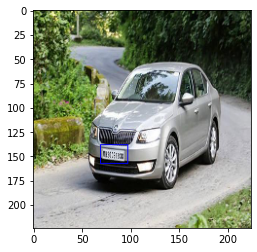

Cropped image ->


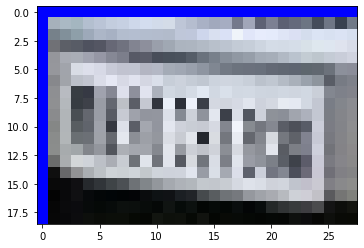


------------------
Figure 183
Original image with rectangle boundary->


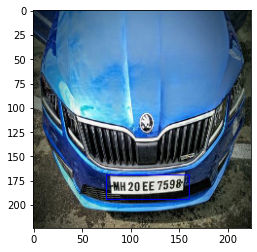

Cropped image ->


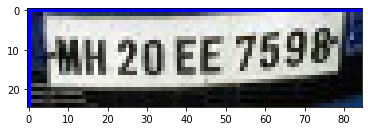

Bhi 20 E€ 7598)

------------------
Figure 184
Original image with rectangle boundary->


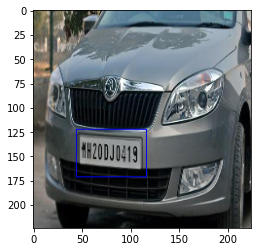

Cropped image ->


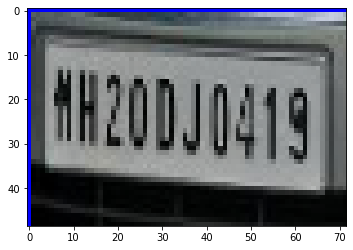


------------------
Figure 185
Original image with rectangle boundary->


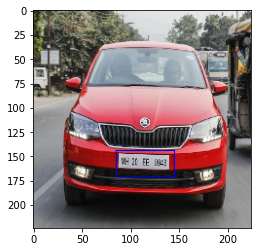

Cropped image ->


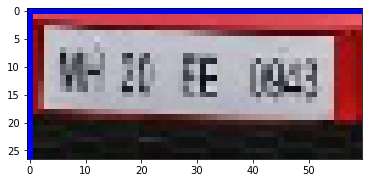


------------------
Figure 186
Original image with rectangle boundary->


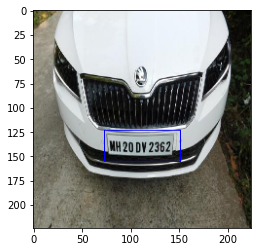

Cropped image ->


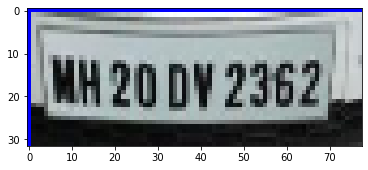

WH 20 2362,

------------------
Figure 187
Original image with rectangle boundary->


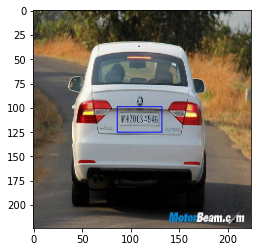

Cropped image ->


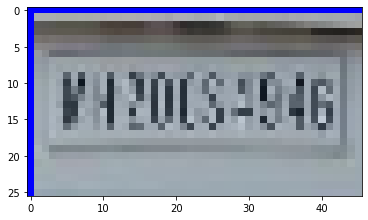

Presse

------------------
Figure 188
Original image with rectangle boundary->


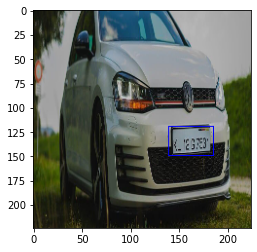

Cropped image ->


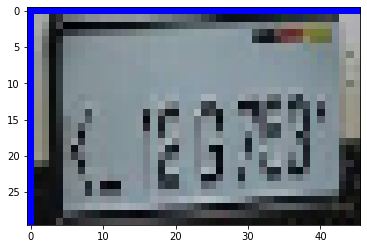


------------------
Figure 189
Original image with rectangle boundary->


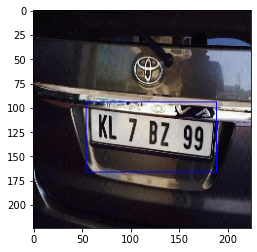

Cropped image ->


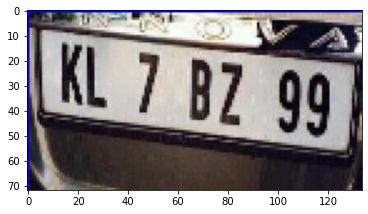

Pay
x 7 BY 99]

------------------
Figure 190
Original image with rectangle boundary->


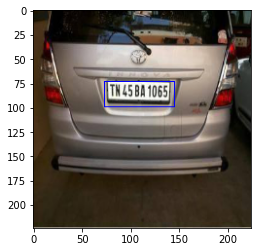

Cropped image ->


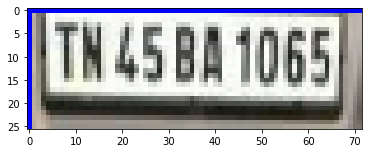

VIM5BA 1055]

------------------
Figure 191
Original image with rectangle boundary->


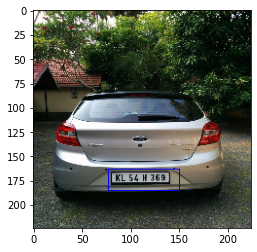

Cropped image ->


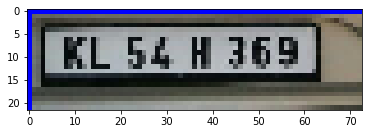

Pk 5.4363)

------------------
Figure 192
Original image with rectangle boundary->


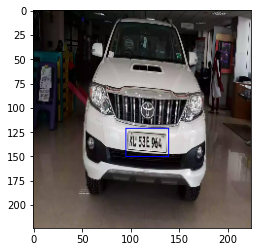

Cropped image ->


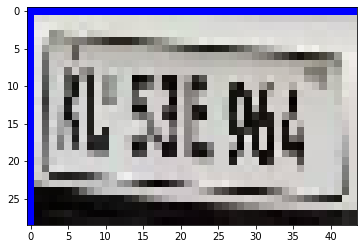


------------------
Figure 193
Original image with rectangle boundary->


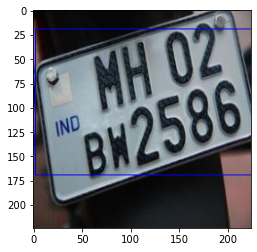

Cropped image ->


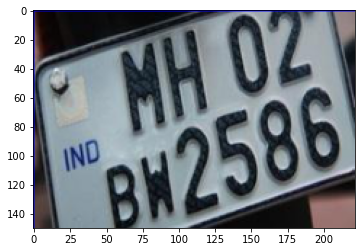


------------------
Figure 194
Original image with rectangle boundary->


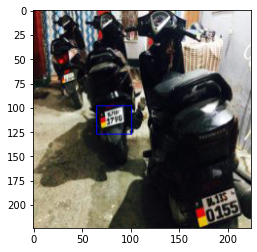

Cropped image ->


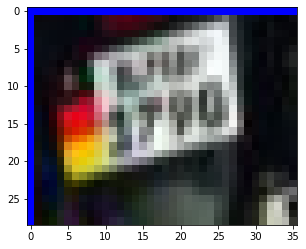

a

------------------
Figure 195
Original image with rectangle boundary->


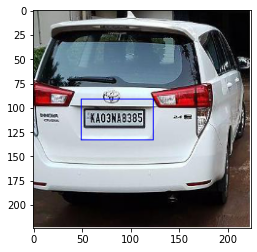

Cropped image ->


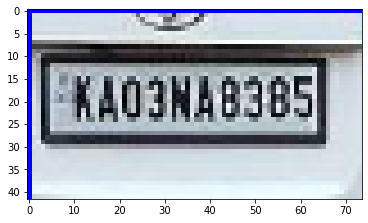


------------------
Figure 196
Original image with rectangle boundary->


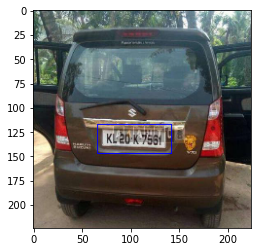

Cropped image ->


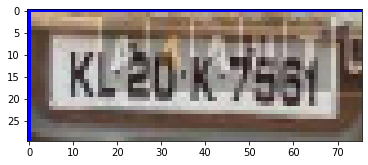


------------------
Figure 197
Original image with rectangle boundary->


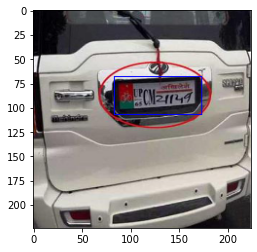

Cropped image ->


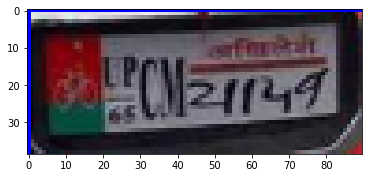

shee

------------------
Figure 198
Original image with rectangle boundary->


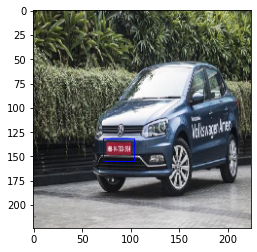

Cropped image ->


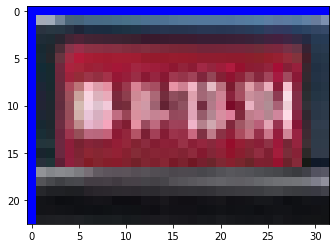


------------------
Figure 199
Original image with rectangle boundary->


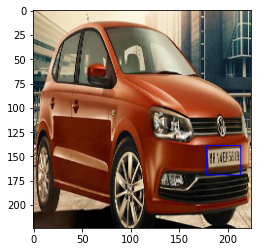

Cropped image ->


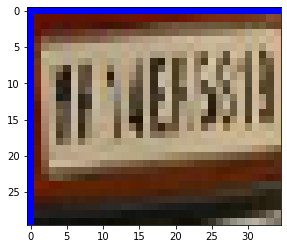

538

------------------
Figure 200
Original image with rectangle boundary->


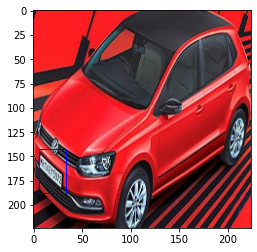

Cropped image ->


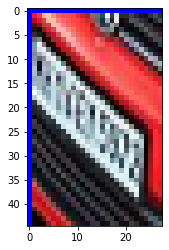

SN

------------------
Figure 201
Original image with rectangle boundary->


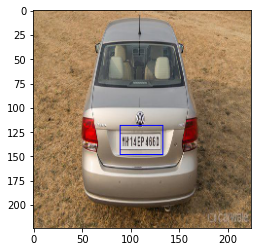

Cropped image ->


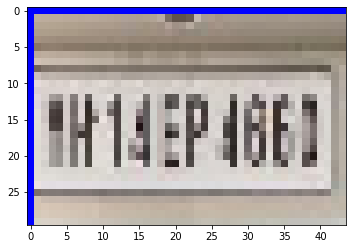

ener)

------------------
Figure 202
Original image with rectangle boundary->


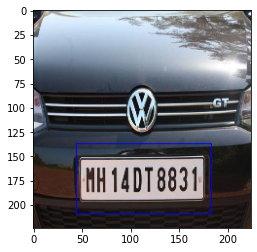

Cropped image ->


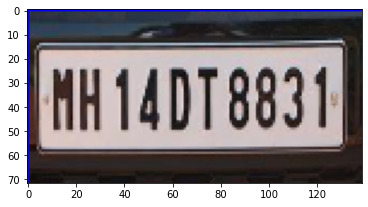

nH 14078831]

------------------
Figure 203
Original image with rectangle boundary->


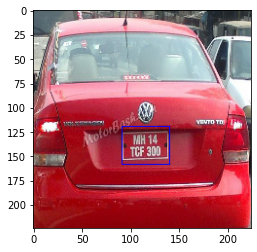

Cropped image ->


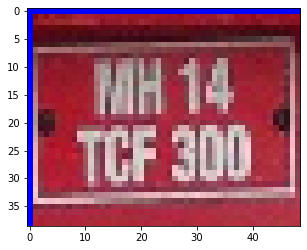

ih

------------------
Figure 204
Original image with rectangle boundary->


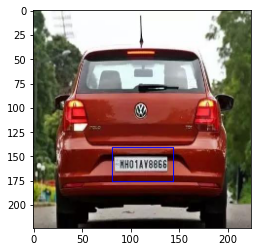

Cropped image ->


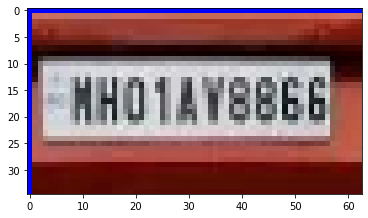


------------------
Figure 205
Original image with rectangle boundary->


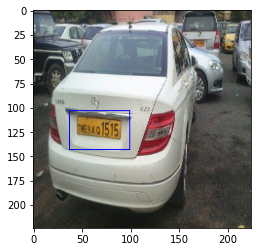

Cropped image ->


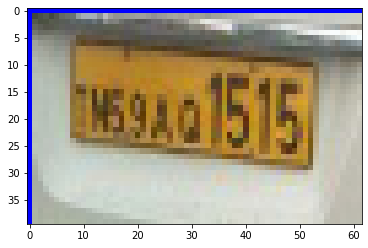

e

------------------
Figure 206
Original image with rectangle boundary->


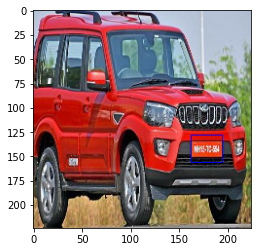

Cropped image ->


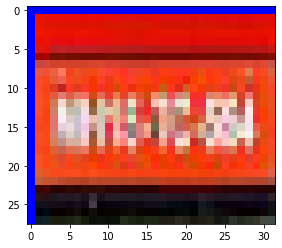

Or

------------------
Figure 207
Original image with rectangle boundary->


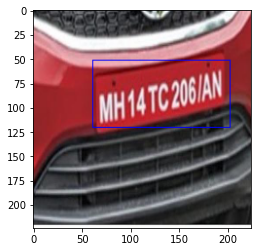

Cropped image ->


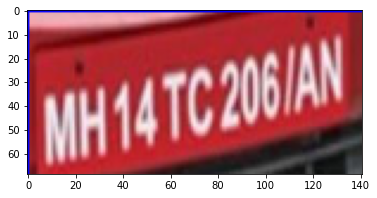

PT

------------------
Figure 208
Original image with rectangle boundary->


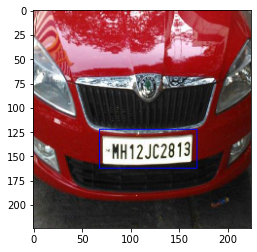

Cropped image ->


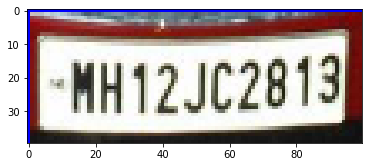

MH 12J02814

------------------
Figure 209
Original image with rectangle boundary->


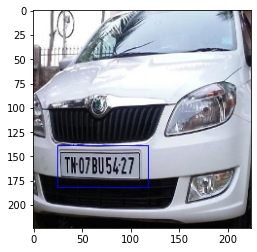

Cropped image ->


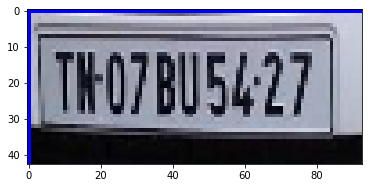

[rearn0sic7

------------------
Figure 210
Original image with rectangle boundary->


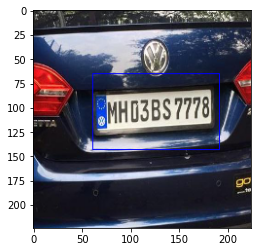

Cropped image ->


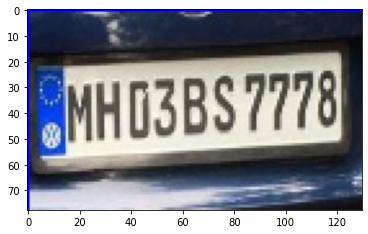

RH OBS 7778
ei, = *

------------------
Figure 211
Original image with rectangle boundary->


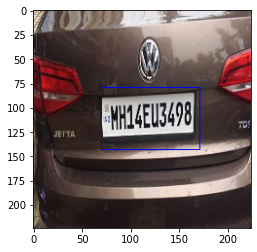

Cropped image ->


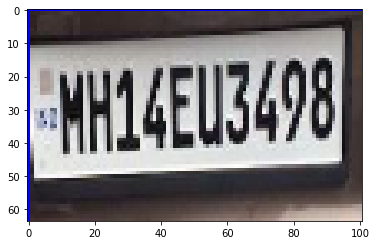

HHLAEUSANS

------------------
Figure 212
Original image with rectangle boundary->


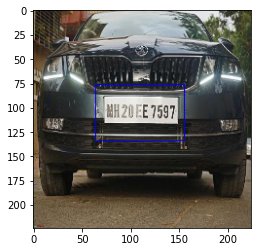

Cropped image ->


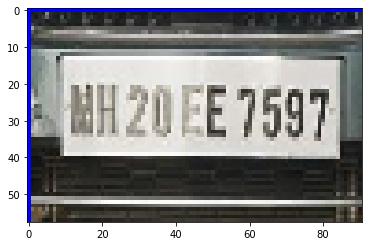

btei l. E 7897)

------------------
Figure 213
Original image with rectangle boundary->


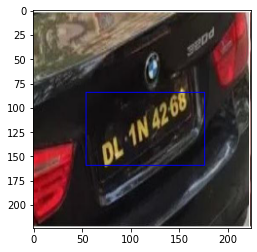

Cropped image ->


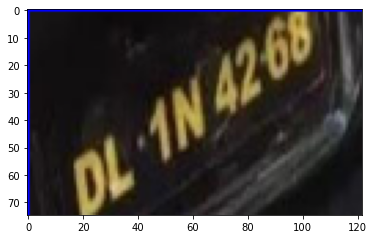

ou e

------------------
Figure 214
Original image with rectangle boundary->


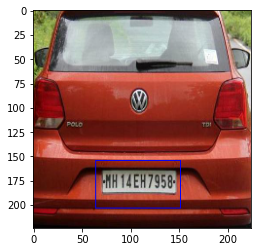

Cropped image ->


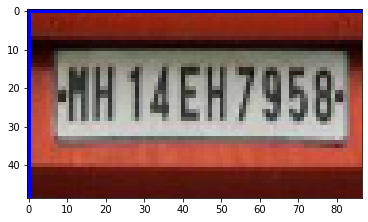

PT EEA

------------------
Figure 215
Original image with rectangle boundary->


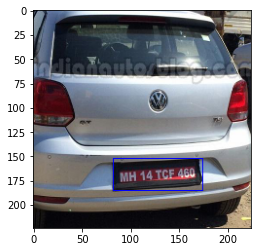

Cropped image ->


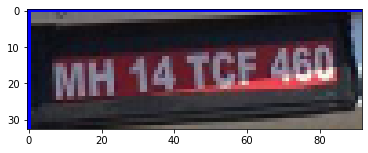

Pree

------------------
Figure 216
Original image with rectangle boundary->


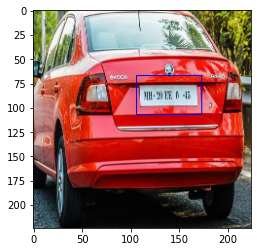

Cropped image ->


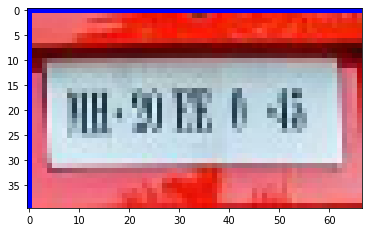


------------------
Figure 217
Original image with rectangle boundary->


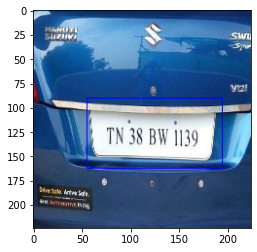

Cropped image ->


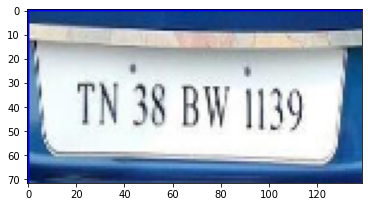

TN 38 BW A) ]

------------------
Figure 218
Original image with rectangle boundary->


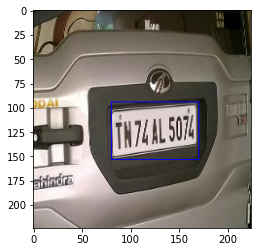

Cropped image ->


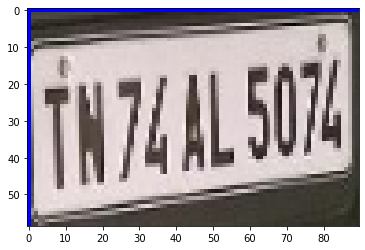


------------------
Figure 219
Original image with rectangle boundary->


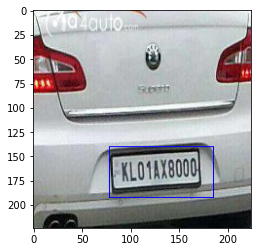

Cropped image ->


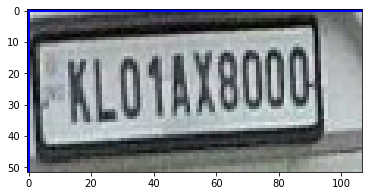

Poveseoy

------------------
Figure 220
Original image with rectangle boundary->


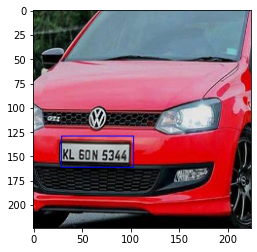

Cropped image ->


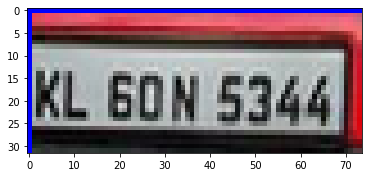

—

------------------
Figure 221
Original image with rectangle boundary->


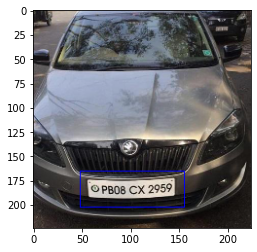

Cropped image ->


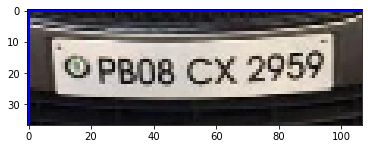


------------------
Figure 222
Original image with rectangle boundary->


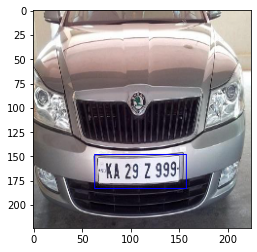

Cropped image ->


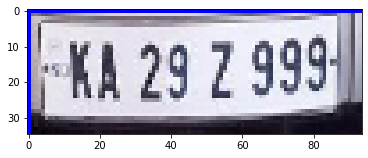

FAA 29 7.999:

------------------
Figure 223
Original image with rectangle boundary->


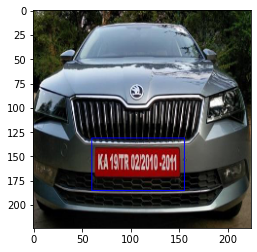

Cropped image ->


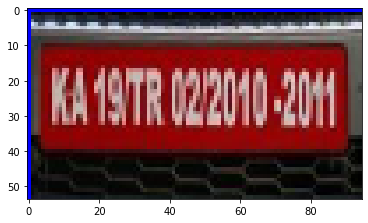

Perea

------------------
Figure 224
Original image with rectangle boundary->


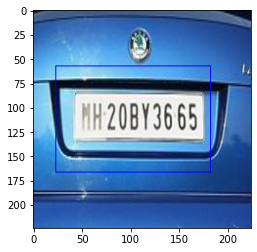

Cropped image ->


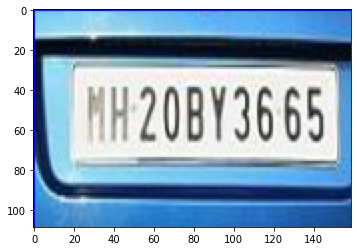

| 20843665,

------------------
Figure 225
Original image with rectangle boundary->


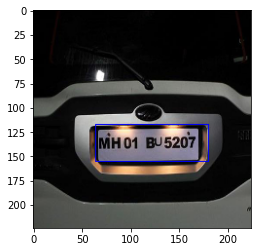

Cropped image ->


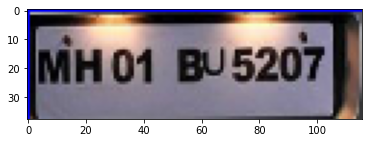

nos posatz|

------------------
Figure 226
Original image with rectangle boundary->


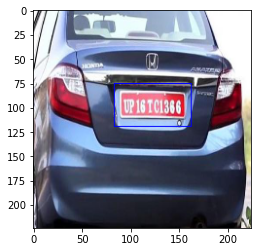

Cropped image ->


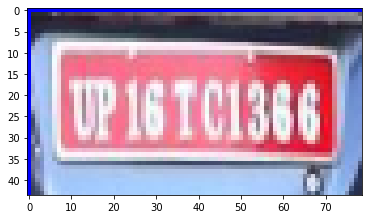

_ 7

------------------
Figure 227
Original image with rectangle boundary->


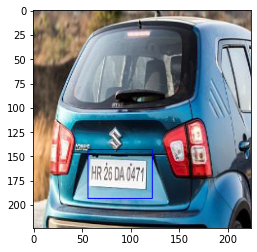

Cropped image ->


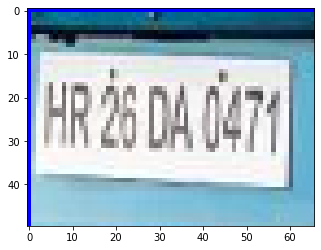


------------------
Figure 228
Original image with rectangle boundary->


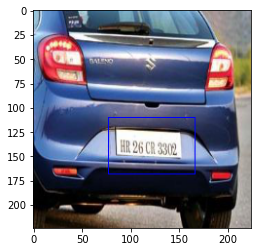

Cropped image ->


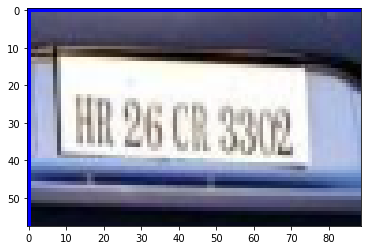


------------------
Figure 229
Original image with rectangle boundary->


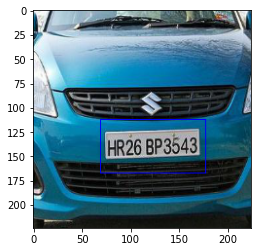

Cropped image ->


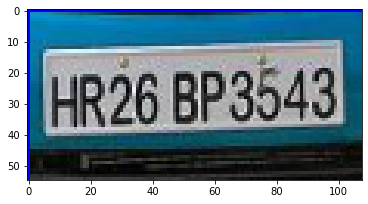

acm "
HR26 BP3543

------------------
Figure 230
Original image with rectangle boundary->


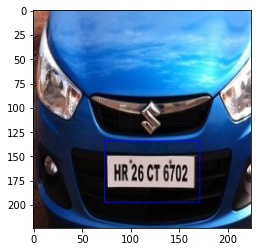

Cropped image ->


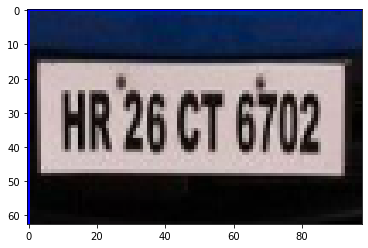

ARIE CT ETN

------------------
Figure 231
Original image with rectangle boundary->


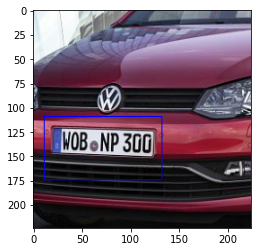

Cropped image ->


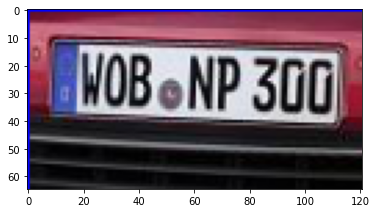

BOB eNP 306)

------------------
Figure 232
Original image with rectangle boundary->


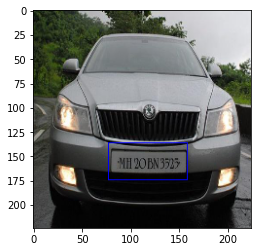

Cropped image ->


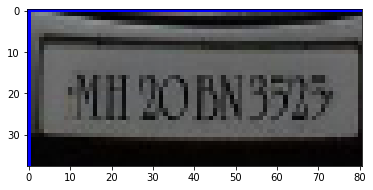


------------------
Figure 233
Original image with rectangle boundary->


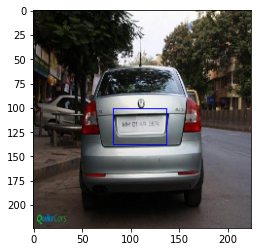

Cropped image ->


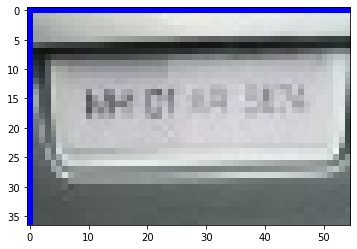


------------------
Figure 234
Original image with rectangle boundary->


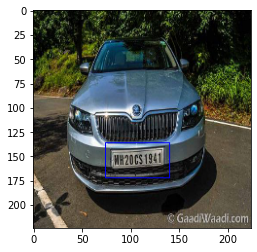

Cropped image ->


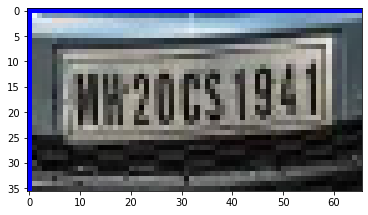


------------------
Figure 235
Original image with rectangle boundary->


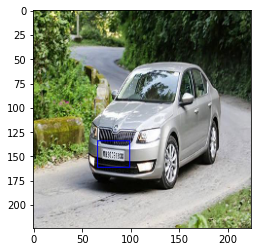

Cropped image ->


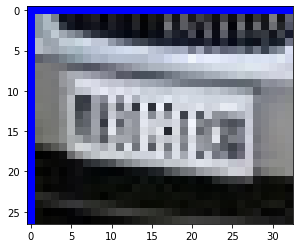

=

------------------
Figure 236
Original image with rectangle boundary->


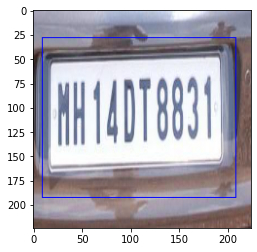

Cropped image ->


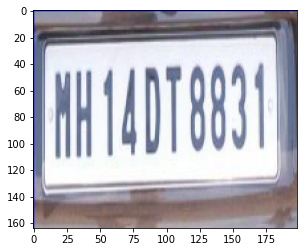

aa

------------------
Total images miss 0


In [47]:
miss_count = 0
for i in range (0,len(license_plate_df)):
    print("Figure {}".format(i))
    miss_count += get_number(i)
    print("------------------")
print("Total images miss {}".format(miss_count))